In [1]:
import cv2
import urllib3
import numpy as np

from PIL import Image

import imutils
from matplotlib import pyplot as plt

In [2]:
def visualize(images,titles,suptitles,n):
    fig, axes = plt.subplots(1, len(images), figsize=(10, 5))
    for i in range(len(images)):
        axes[i].imshow(images[i], cmap='gray')
        axes[i].set_title(titles[i])
        axes[i].axis("off")
    if suptitles != None:
        plt.suptitle(suptitles[n])
    plt.tight_layout()
    plt.show()

from scipy.spatial.distance import cdist

def visualize_clusters(image, corners, threshold, min_cluster_distance=20):
    # Create an image copy for visualization
    image_vis = cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)

    # Threshold the corners to create a binary mask
    _, binary_mask = cv2.threshold(corners, threshold * corners.max(), 255, cv2.THRESH_BINARY)

    # Find non-zero coordinates in the binary mask
    corner_coordinates = np.column_stack(np.where(binary_mask > 0))

    # Calculate pairwise distances between corner coordinates
    pairwise_distances = cdist(corner_coordinates, corner_coordinates)

    # Create a figure and axis
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.imshow(image_vis, cmap='gray')

    # As some clusters may overlap with other we use minumum distance to reduce the number of clusters with are almost the same.
    merged_clusters = set()

    for i in range(len(corner_coordinates)):
        if i not in merged_clusters:
            # Get coordinates of the current cluster
            current_coords = corner_coordinates[i]

            # Find clusters within the minimum distance threshold
            close_clusters = np.where(pairwise_distances[i] < min_cluster_distance)[0]

            # Mark the clusters as merged
            merged_clusters.update(set(close_clusters))

            # Plot a circle around the merged clusters
            merged_coords = corner_coordinates[close_clusters]
            average_coords = np.mean(merged_coords, axis=0)
            circle = plt.Circle((average_coords[1], average_coords[0]), radius=7, color='r', fill=False)
            ax.add_patch(circle)

    ax.set_title('Harris-Laplace Clustering (Minimum Distance Filter)')
    plt.show()
def visualize_affine_corners(image, detected_affine_features):
    visualized_image = image.copy()

    # Draw ellipses around detected affine features
    for feature in detected_affine_features:
        x, y, _, _, orientation = feature
        # Set fixed values for major and minor axes
        major_axis = 20  
        minor_axis = 10  
        cv2.ellipse(visualized_image, (x, y), (int(major_axis), int(minor_axis)), orientation, 0, 360, (0, 255, 0), 1)


    # Display the result using matplotlib
    plt.figure(figsize=(8, 8))
    plt.imshow(cv2.cvtColor(visualized_image, cv2.COLOR_BGR2RGB))
    plt.title('Harris-Affine Corner Detector')
    plt.axis('off')
    plt.show()


# Block 4. Feature detection, Image descriptors and BoVW

This lab explores the fundamental concepts of feature extraction and feature descriptors in computer vision. It delves into various feature detection techniques like Harris corner and LoG blob detectors, and descriptor methods like SIFT, SURF, and ORB. Additionally, the lab introduces the Bag of Visual Words model, demonstrating its application in image classification, particularly using a subset of the VOC dataset.

### Objectives:
1. **Implement Feature extraction methods**
  - **Implement Harris Corner Detector**: Understand and implement the Harris corner detection algorithm to identify corner features in images.
  - **Implement LoG Blob Detector**: Learn and apply the Laplacian of Gaussian method for blob detection in images.
2. **Implement Image feature descriptors** (Reusing part of the feature extraction code)
  - **Implement Normalized Color Histogram and Color Space Changes**: Explore color features by implementing normalized color histograms and understanding the impact of different color spaces.
  - **Use SIFT, SURF, and ORB**: Use these feature descriptors, analyze their strengths and weaknesses, and compare their performance.
3. **Provide a Pipeline for Bag of Words and Compute Results on Subset of VOC Dataset**: Develop a Bag of Visual Words model and test its efficacy in classifying images from a subset of the VOC dataset.

---

### Mandatory Questions:

1. Explain the principles behind corner detectors, specifically the Harris corner detection method. Why is it effective in identifying corners?
2. Discuss the main differences between edge detection and corner detection. Why are corners considered more robust features?
3. What are the limitations of the Harris corner detector in complex images?
4. Describe the Laplacian of Gaussian blob detector. How does it differ from edge detection?
5. Discuss the role of feature descriptors in object recognition.
6. Why are color histograms useful for image feature extraction? Describe the process of creating a normalized color histogram.
7. How does a change in color space affect feature extraction in images?
8. Explain the concepts of scale and rotation invariance in feature detection. For each algorithm (SIFT, SURF, and ORB), explain how they handle scale and rotation variations in images.
9. Compare SIFT, SURF, and ORB in terms of computational efficiency and accuracy.
10. What is the role of orientation assignment in the SIFT algorithm?
11. How does the ORB algorithm differ from SIFT and SURF in terms of feature matching?
12. How do feature descriptors contribute to the process of image stitching (for panorama images)?
13. Discuss the impact of varying lighting conditions on feature detection and description. How can these challenges be mitigated?
14. What are the key steps in constructing a Bag of Visual Words model? Explain each of them in detail.
15. In the context of the Bag of Visual Words model, explain the significance of feature quantization. Discuss on which steps it can be done and how it affects the results.


### Optional Deep Dive Questions:

1. Discuss the potential weaknesses of the LoG blob detector in real-world scenarios. Propose improvements.
2. Explore the potential of hybrid color spaces (combining properties of different color models) in improving the robustness of feature extraction for applications in varied lighting and environmental conditions.
3. Discuss the impact of varying image resolutions on the effectiveness of feature descriptors.
4. Discuss the limitations of current feature descriptors in handling occlusions and propose potential improvements.
5. Evaluate the performance of hybrid feature detectors that combine the properties of multiple algorithms (like SIFT and Harris). What are the potential benefits?
6. Analyze the role of feature extraction in content-based image retrieval systems. How do they impact the efficiency and accuracy of searches?
7. How might the Bag of Visual Words model be modified or extended to improve classification accuracy?
8. Consider the role of context in feature-based image classification. How might contextual information be incorporated into the Bag of Visual Words model?


### Exercise 1: Harris Corner Detector Implementation
**Objective**:

Implement the Harris Corner Detection algorithm to identify corner features in images.

**Guideline**:
- Load image.
- Implement the basic Harris Corner Detection algorithm.
- Apply the algorithm to the images and visualize the detected corners.
- Explore the impact of parameter changes on detection quality.
- (Optional) Implement the Harris-Laplace and the Harris-Affine improvments and compare the pros and cons of each version

**Expected Results**:
- A working Harris Corner Detection implementation.
- Visualization of corner detection in various images.

In [3]:
def corner_harris_manual(gray, block_size, ksize, k):
    # Calculate gradients using sobel
    Ix = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=ksize)
    Iy = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=ksize)

    # Compute components of the Harris matrix
    Ixx = Ix**2
    Iyy = Iy**2
    Ixy = Ix * Iy

    # Compute sums of the products of derivatives at each pixel
    Sxx = cv2.boxFilter(Ixx, -1, (block_size, block_size), normalize=False)
    # The depth is set to -1--> destination image same depth as the source.
    # The follwing parameters represent the size of the box window
    # Normalized = Flase. The function use a box filter, not a normalized box filter. 
    Syy = cv2.boxFilter(Iyy, -1, (block_size, block_size), normalize=False)
    Sxy = cv2.boxFilter(Ixy, -1, (block_size, block_size), normalize=False)

    # Compute the determinant and trace of the Harris matrix at each pixel
    det_M = (Sxx * Syy) - (Sxy**2)
    trace_M = Sxx + Syy

    # Harris response
    harris_response = det_M - k * (trace_M**2)

    return harris_response

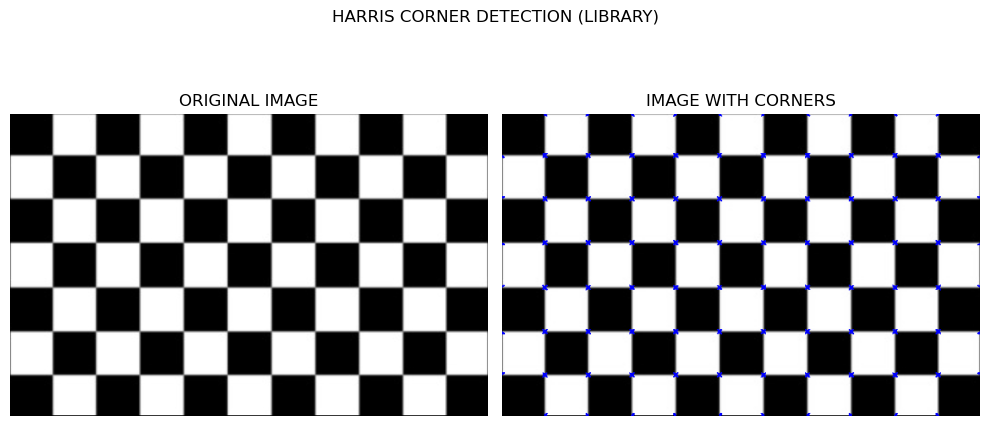

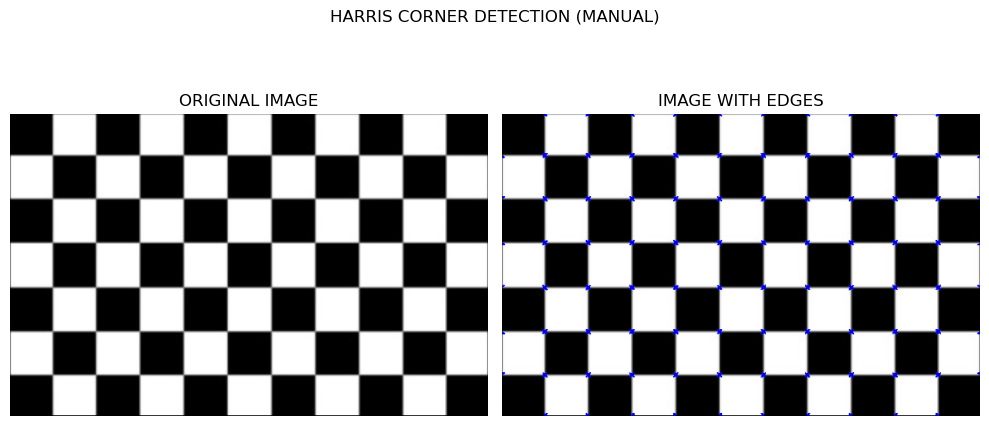

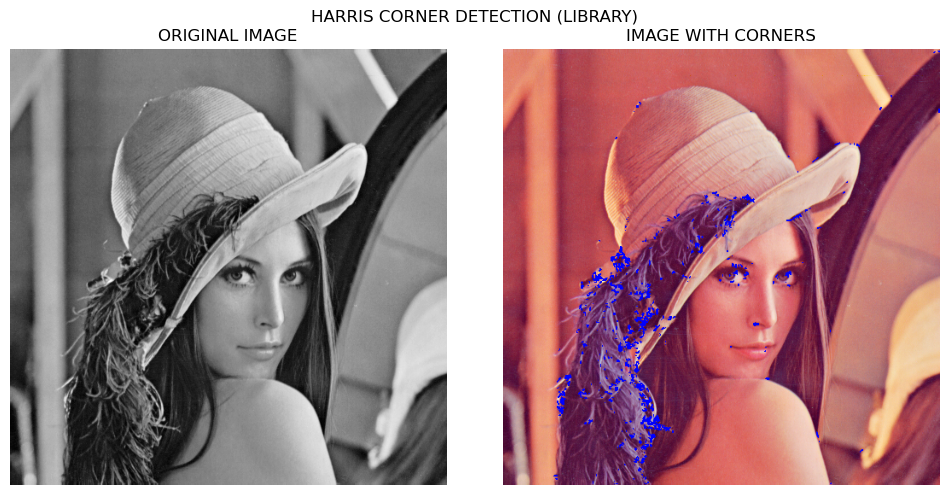

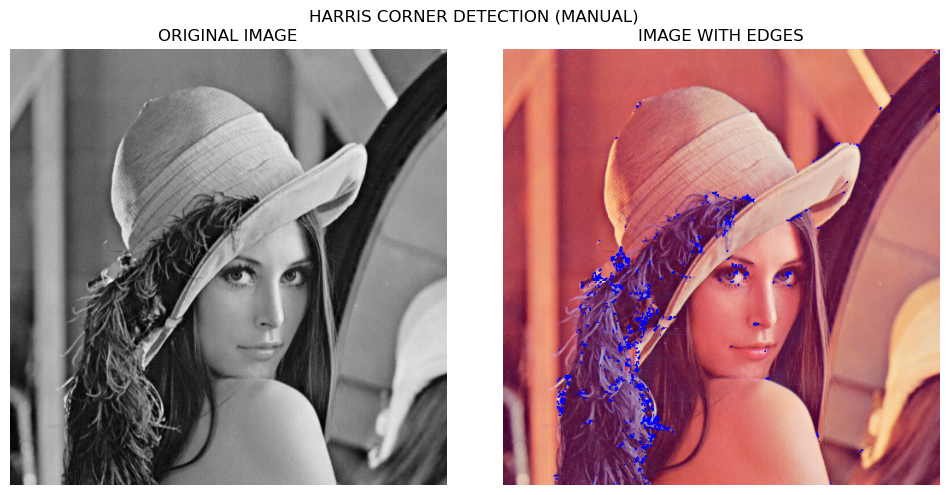

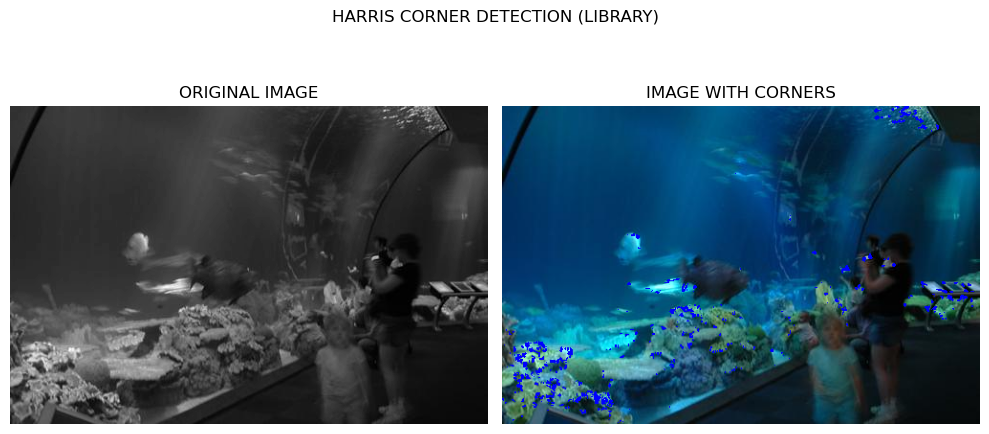

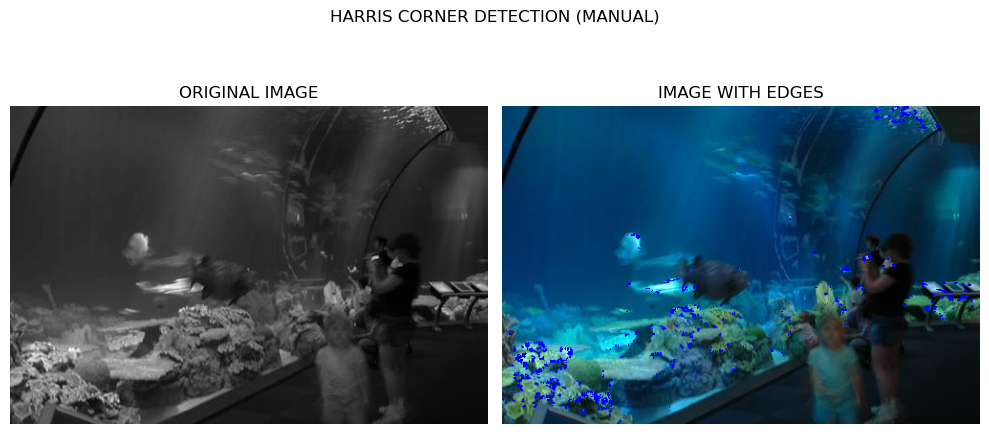

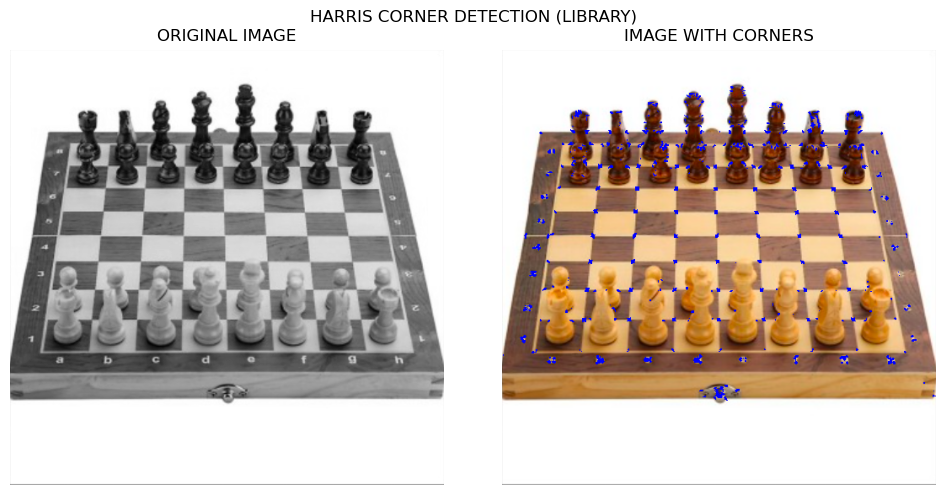

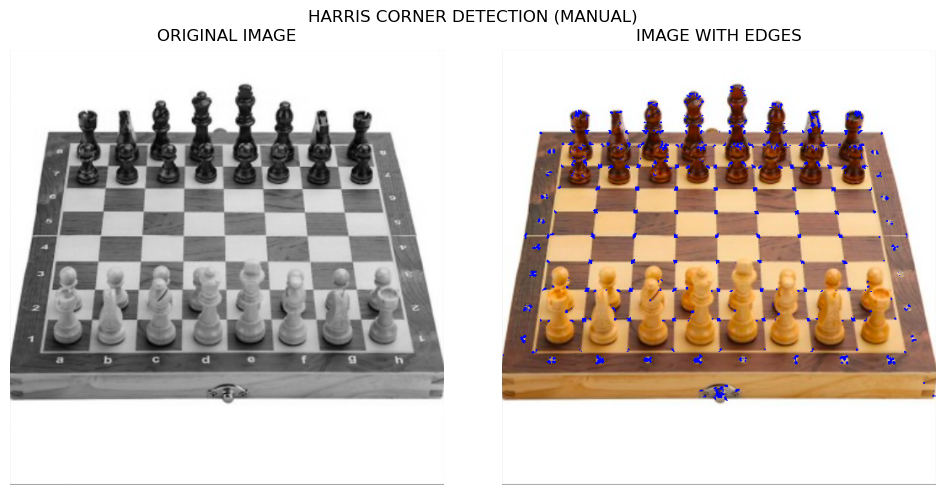

In [4]:
#images = ["sun_akcmnzygfvynokzd.jpg"]
images = ["image_new.png","lenna.png","dataset/train/aquarium/sun_akcmnzygfvynokzd.jpg", "chess.png"]
blocksize = int(input("BLOCK SIZE: "))  # 3
kernel_size = int(input("KERNEL SIZE: "))  # 5
K_value = float(input(" K_VALUE: "))  # small value more detectors, e.g., 0.04
for image_path in images:
    image1 = cv2.imread(f"{image_path}", cv2.IMREAD_COLOR)
    image1 = cv2.cvtColor(image1,cv2.COLOR_BGR2RGB)
    image2 = cv2.imread(f"{image_path}", cv2.IMREAD_COLOR)
    image2 = cv2.cvtColor(image2,cv2.COLOR_BGR2RGB)
    image = cv2.imread(f"{image_path}", cv2.IMREAD_GRAYSCALE)
    
    if image is None:
        print("Image not found")
    else:
        operatedImage = np.float32(image.copy())  # Make a copy to avoid modifying the original
        dest = cv2.cornerHarris(operatedImage, blocksize, kernel_size, K_value)#After this we could dilate the corners however to obtain the same result as manual we would avoid it
        output = corner_harris_manual(image,blocksize,kernel_size, K_value)#manual implementation
        # Mark the corners in color
        image1[dest > 0.01 * dest.max()] = [0, 0, 255] 
        image2[output > 0.01 * output.max()] = [0, 0, 255] 

        visualize([image, image1], ["ORIGINAL IMAGE", "IMAGE WITH CORNERS"],
                  ["HARRIS CORNER DETECTION (LIBRARY)"], 0)
        visualize([image, image2], ["ORIGINAL IMAGE", "IMAGE WITH EDGES"],
                  ["HARRIS CORNER DETECTION (MANUAL)"], 0)

### (Optional) Exercise 1.5. Implement the Harris-Laplace and the Harris-Affine improvments and compare the pros and cons of each version

**1.5.1 HARRIS-LAPLACE**

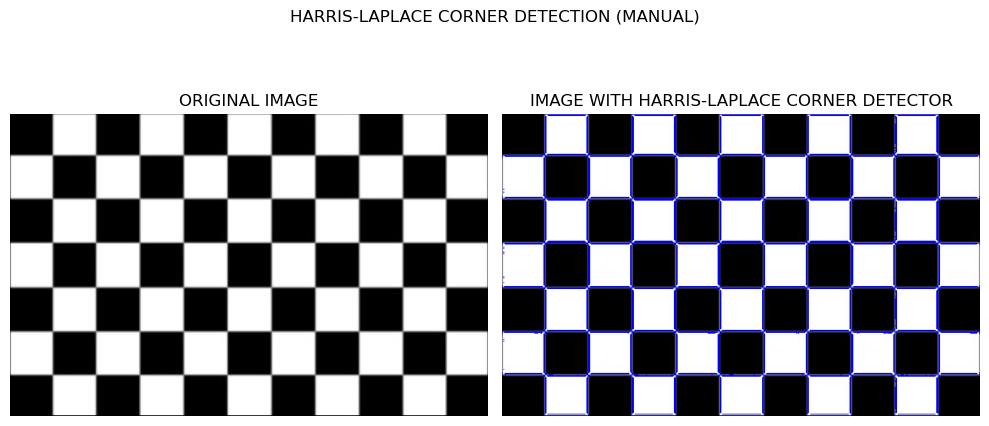

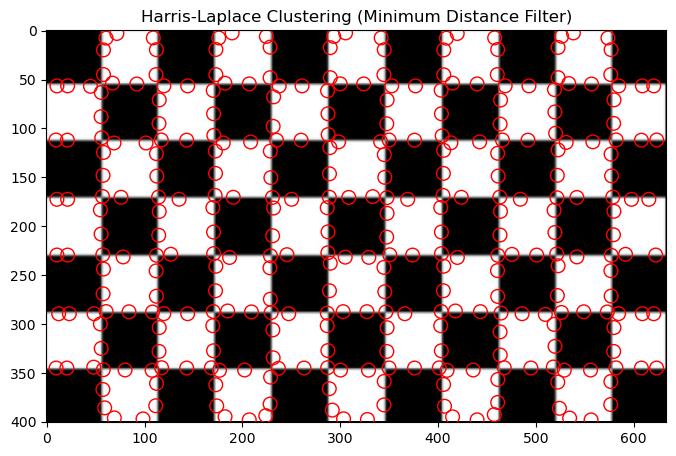

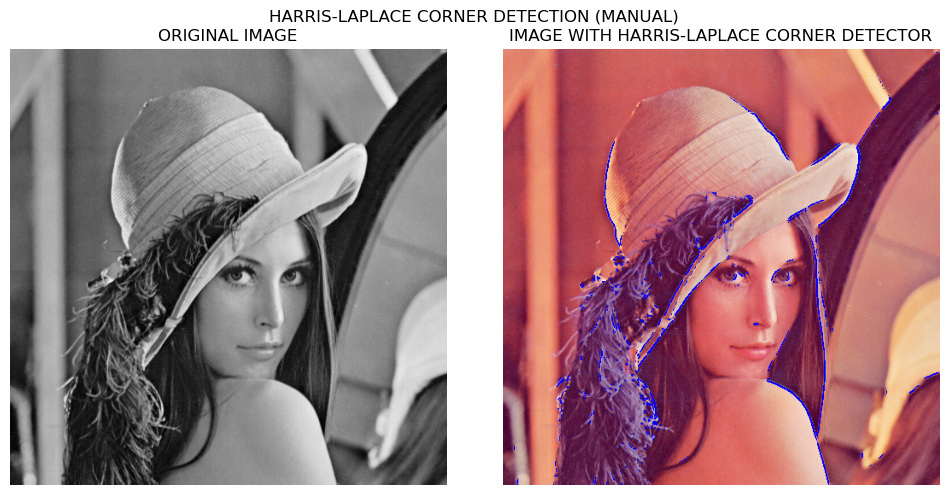

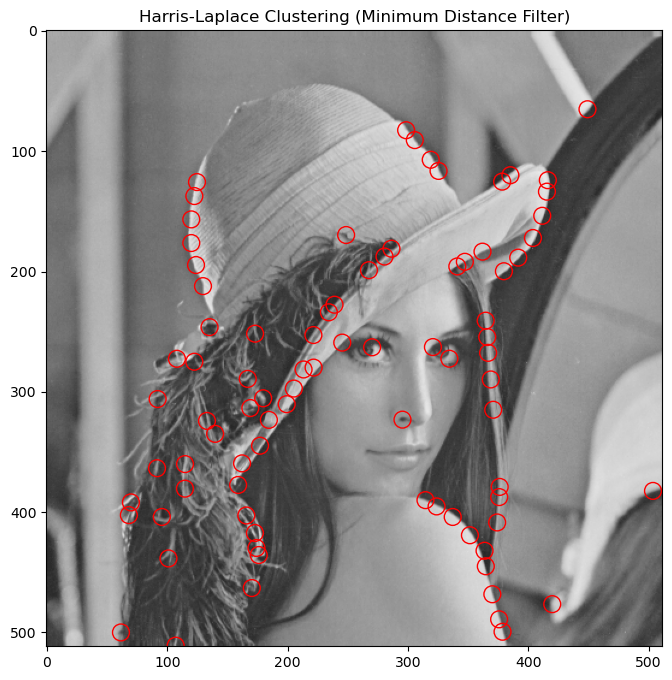

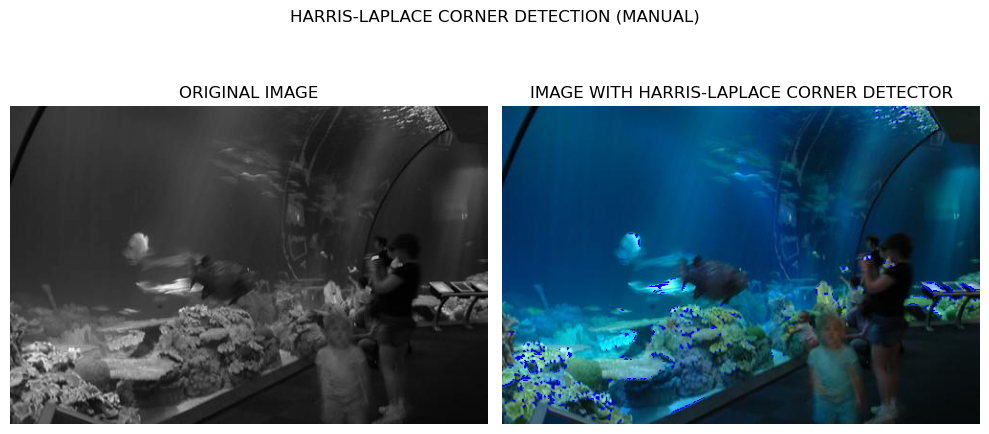

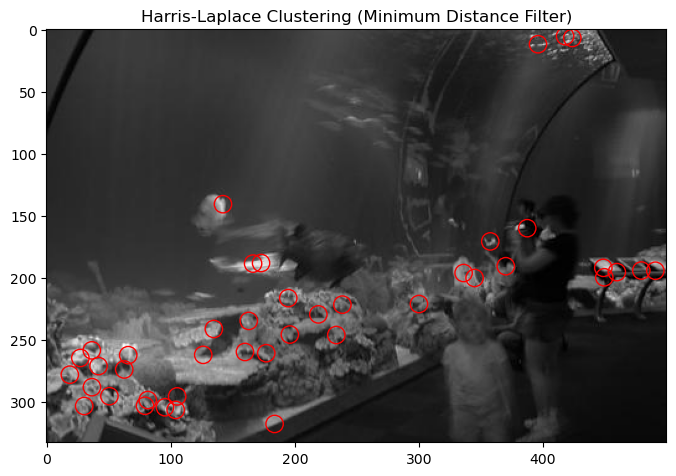

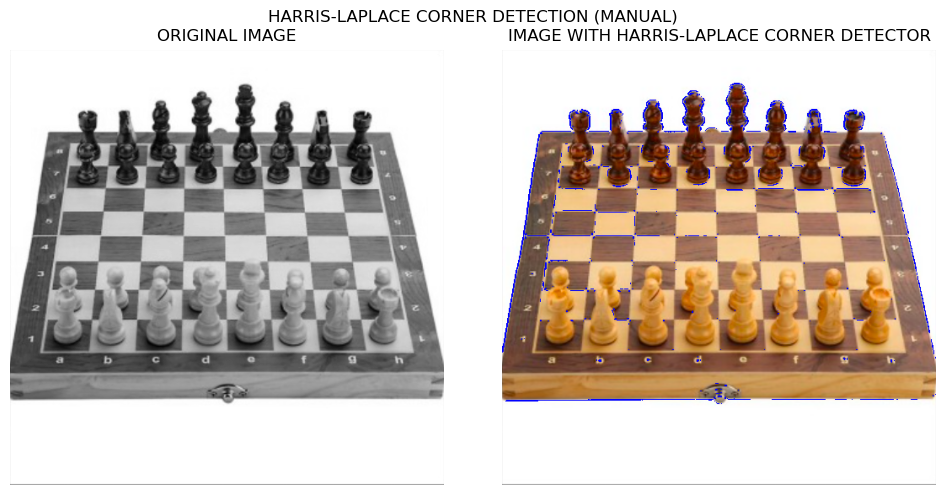

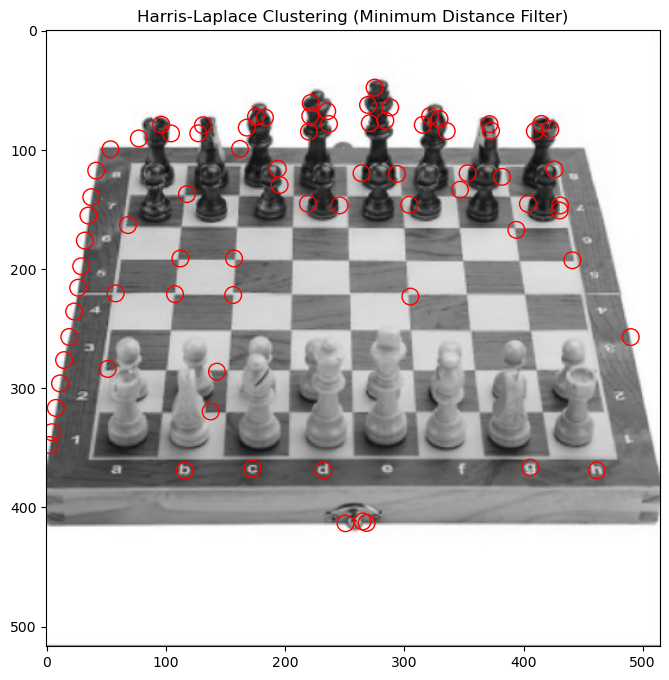

In [5]:
def harris_laplace(image, block_size, ksize, k_harris, laplacian_kernel_size):
    # Compute Harris response
    harris_response = corner_harris_manual(image, block_size, ksize, k_harris)

    # Compute Laplacian of Gaussian (LoG)
    log = cv2.GaussianBlur(image, (laplacian_kernel_size, laplacian_kernel_size), 0)
    log = cv2.Laplacian(log, cv2.CV_64F, ksize=laplacian_kernel_size)

    # Compute Harris-Laplace response
    harris_laplace_response = harris_response * log

    return harris_laplace_response

images = ["image_new.png","lenna.png","dataset/train/aquarium/sun_akcmnzygfvynokzd.jpg", "chess.png"]
block_size = int(input("BLOCK SIZE: "))  # 3
kernel_size = int(input("KERNEL SIZE (Harris): "))  # 5
k_value_harris = float(input("K_VALUE (Harris): "))  # small value more detectors, e.g., 0.04 (threshold)
laplacian_kernel_size = int(input("Laplacian KERNEL SIZE: "))  # 3
for image_path in images:
    image2 = cv2.imread(f"{image_path}", cv2.IMREAD_COLOR)
    image2 = cv2.cvtColor(image2,cv2.COLOR_BGR2RGB)
    image = cv2.imread(f"{image_path}", cv2.IMREAD_GRAYSCALE)

    if image is None:
        print("Image not found")
    else:
        # Harris-Laplace
        harris_laplace_response = harris_laplace(image, block_size, kernel_size, k_value_harris, laplacian_kernel_size)
        image2[harris_laplace_response > 0.01 * harris_laplace_response.max()] = [0, 0, 255] 
        visualize([image, image2], ["ORIGINAL IMAGE", "IMAGE WITH HARRIS-LAPLACE CORNER DETECTOR"],
                  ["HARRIS-LAPLACE CORNER DETECTION (MANUAL)"], 0)
        visualize_clusters(image, harris_laplace_response,k_value_harris)

**1.5.2 HARRIS-AFFINE**

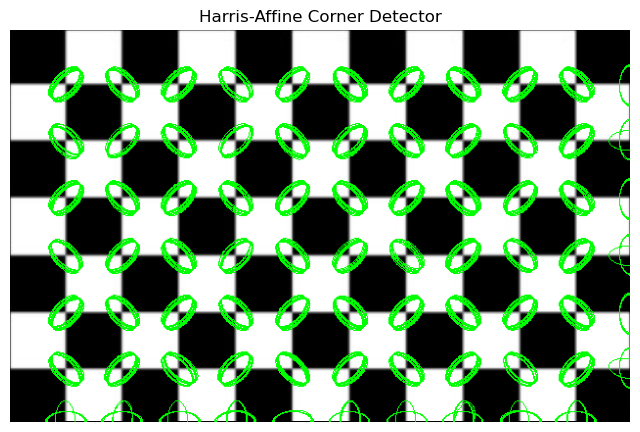

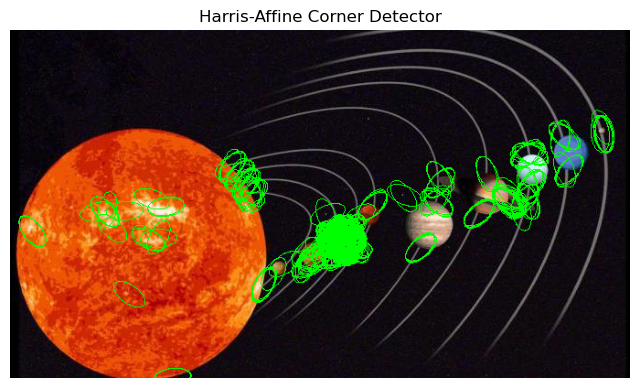

In [6]:
def harris_affine_corner_detector(image, threshold=0.01, sigma=1.0, k=0.04, laplace_threshold=0.01):
    # Step 1: Compute Harris corner response
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = np.float32(gray)
    harris_response = cv2.cornerHarris(gray, blockSize=2, ksize=3, k=k)

    # Step 2: Find Harris corners above a certain threshold
    corners = np.argwhere(harris_response > threshold * harris_response.max())
    corners = np.intp(corners)  # Convert to integer indices

    # Step 3: Compute Laplacian of Gaussian (LoG)
    image_log = cv2.GaussianBlur(gray, (0, 0), sigma)  # Apply Gaussian blur
    laplacian = cv2.Laplacian(image_log, cv2.CV_32F, ksize=3)

    # Step 4: Select corners with positive Laplacian response and above Laplace threshold
    laplace_response = laplacian[corners[:, 0], corners[:, 1]]
    selected_corners = corners[laplace_response > laplace_threshold * laplace_response.max()]

    # Step 5: Compute affine shape for each selected corner
    affine_features = []
    for corner in selected_corners:
        x, y = corner[1], corner[0]  # Corrected order for indexing
        window_size = 5  # Adjust the window size as needed

        # Extract the local patch around the corner
        patch = gray[y - window_size:y + window_size + 1, x - window_size:x + window_size + 1]

        # Compute affine shape parameters using moments
        moments = cv2.moments(patch)

        # Check for non-zero eigenvalues
#Calculate the moments of a 2D point set or the image moments of a grayscale image. 
#Moments are statistical measures that describe the distribution of intensity in an image or a set of points.
        if moments['mu20'] * moments['mu02'] - moments['mu11']**2 > 0:
            M = np.array([[moments['mu20'], moments['mu11']], [moments['mu11'], moments['mu02']]])

            # Compute eigenvalues and eigenvectors of M
            _, eigenvalues, eigenvectors = cv2.eigen(M)

            # Extract affine shape parameters
            major_axis_length = 1 / np.sqrt(eigenvalues[0])
            minor_axis_length = 1 / np.sqrt(eigenvalues[1])
            orientation = np.arctan2(eigenvectors[0, 1], eigenvectors[0, 0])

            # Store affine features
            affine_features.append((x, y, major_axis_length, minor_axis_length, np.degrees(orientation)))

    return affine_features

images = ["image_new.png","solar.jpg"]
threshold=0.01
sigma=1.0 
k=0.04
laplace_threshold_size=0.01
for image_path in images:
    image = cv2.imread(f"{image_path}")
    if image is None:
        print("Image not found")
    else:
        detected_affine_features = harris_affine_corner_detector(image)
        visualize_affine_corners(image, detected_affine_features)




### Exercise 2: LoG Blob Detector Implementation
**Objective**:

Develop and apply the LoG method for blob detection in images, understanding its application in feature extraction.

**Guideline**:
- Select diverse images for blob detection.
- Implement the LoG Blob Detector.
- Analyze the LoG method's effectiveness.
- Compare LoG with other blob detection methods.
- (Optional) Implement your own version of other methods (DoG, DoH, ...) or design your own

**Expected Results**:
- Documented LoG Blob Detector implementation.
- Comparative analysis of blob detection results.
- Evaluation of method effectiveness and limitations.


**MANUAL IMPLEMENTATION OF LoG (Laplacian of Gaussian)**

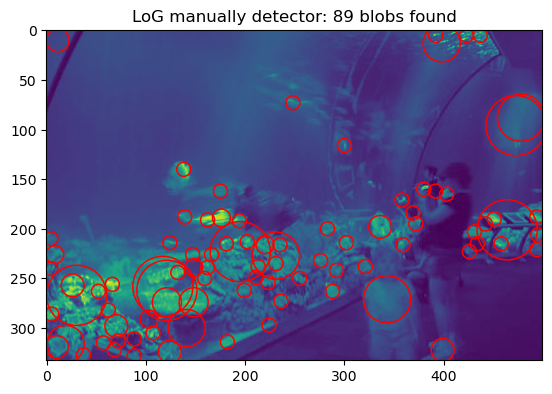

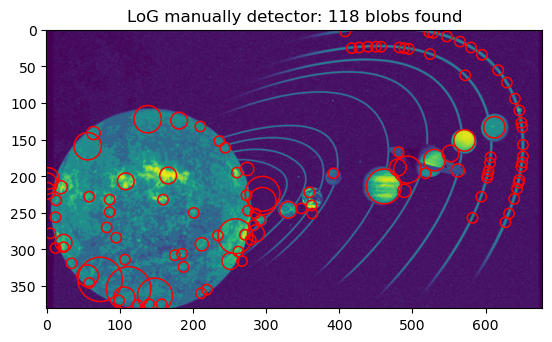

In [9]:
# Import necessary libraries
import numpy as np  
from PIL import Image 
import matplotlib.pyplot as plt 
from matplotlib.patches import Circle  
from scipy.ndimage import convolve, zoom  
# Function to perform 2D convolution on an image with a given kernel
def conv2d(image, kernel, mode='constant'):  # This function takes an image and a kernel and convolves the image with the kernel.
    return convolve(image, kernel, mode=mode)  # The convolve function from scipy.ndimage --> convolution.

# Function to resize an image to given dimensions using interpolation
def Resize(img, out_dims):  # This function resizes an image to the specified dimensions.
    return zoom(img, (out_dims[0] / img.shape[0], out_dims[1] / img.shape[1]), order=1)  # The zoom function from scipy.ndimage --> resizing.

# Function to create a Laplacian of Gaussian (LoG) filter with a given sigma value
def LoG_filter(sigma): 
    n = int(2 * np.ceil(sigma * 2.5) + 1)  # Size of the filter determined by the sigma value.
    Log = np.zeros((n, n))  # Emplty filter matrix.
    for i in range(int(-np.floor(n/2)), int(np.floor(n/2)) + 1): 
#The np.floor function is used here to round down the value of n/2 to the nearest whole number. This is done because the range 
#function in Python requires integer arguments, and n/2 could potentially be a floating-point number if n is odd.
#The expression int(-np.floor(n/2)) == starting index, and int(np.floor(n/2)) + 1 == ending index
        for j in range(int(-np.floor(n/2)), int(np.floor(n/2)) + 1): 
            Log[i + int(np.floor(n/2)), j + int(np.floor(n/2))] = \
                -(1/(np.pi * sigma ** 4)) * (1-((i**2 + j**2)/(2*sigma**2))) * \
                np.exp(-((i**2 + j**2)/(2*sigma**2))) * (sigma**2)  # Value of the filter at that position --> computed by LoG formula.
    return Log 

# Function to replace each pixel in an image with the maximum pixel value in its neighborhood
def max_replace2(array, n):  
    rows, cols = array.shape  
    res_arr = np.zeros((rows, cols))  # Empty array 
    for i in range(rows):  
        for j in range(cols):  
            a, b = max(0, i-(n-1)//2), max(0, j-(n-1)//2)  # Top-left corner of the neighborhood.
            a1, b1 = min(rows, i+1+(n-1)//2), min(cols, j+1+(n-1)//2)  # Bottom-right corner of the neighborhood.
            neighb = array[a:a1, b:b1]  # Neighborhood of the pixel extracted.
            res_arr[i, j] = np.max(neighb)  # Maximum value in the neighborhood --> new pixel value.

    return res_arr  

# Function to create a scale space representation of an image
def scale_space_create(img, sigma, n): 
    k = 2**(0.35)  # The scaling factor between different scales in the scale space.
    org_row, org_col = img.shape 
    scale_space = np.zeros((org_row, org_col, n))  # Empty 3D array 
    Scale_Space = np.zeros((org_row, org_col, n))  # Empty 3D array -> maximum response at each pixel.

    for i in range(n): 
        Log = LoG_filter(sigma)  # Create a LoG filter.
        out_row, out_col = int(np.floor(org_row * 1/k**(i))), int(np.floor(org_col * 1/k**(i)))  # Rows and columns in the downsampled image.
        image_down = Resize(img, [out_row, out_col])  # Downsampling image based on the new dimensions.
        Log_filtered = conv2d(image_down, Log) 
        Log_filtered = np.power(Log_filtered, 2)  #Square results to have positive values
        scale_space[:, :, i] = Resize(Log_filtered, [org_row, org_col])  # Resize to the original dimensions and stored in the scale space.
        Scale_Space[:, :, i] = max_replace2(scale_space[:, :, i], 7)  # Maximum response at each pixel in the neighborhood .
        img = conv2d(img, np.array([[1, 2, 1], [2, 4, 2], [1, 2, 1]]) / 16.0 )  # Smooth using a Gaussian filter.

    return scale_space, Scale_Space

# Function to find the scale at which each pixel achieves its maximum response
def find_scale(org_row, org_col, Scale_Space):
    max_scale = np.zeros_like(Scale_Space)  
    for i in range(org_row):  
        for j in range(org_col): 
            ind = np.unravel_index(np.argmax(Scale_Space[i, j, :]), Scale_Space[i, j, :].shape)  # Index of the maximum response at a pixel.
            max_scale[i, j, ind[0]] = Scale_Space[i, j, ind[0]]  # Stored the maximum response

    return max_scale 

# Function to find circles in an image
def find_circles(max_scale, threshold, sigma):  
    radius = []  
    coord = []  
    k = 2**(0.35)  # Scaling factor between different scales in the scale space.

    for i in range(max_scale.shape[2]):  # For each scale...
        ind = np.argwhere(max_scale[:, :, i] >= threshold)  # Indices of the pixels: response >threshold .
        radius = np.ones((ind.shape[0], 1)) * (2 ** 0.5 * sigma * k**(i))  # Radius of the circles.
        coord.append(np.concatenate((ind, radius), axis=1))  # Coordinates: radius and index.
    cc = np.vstack(coord)  # Coordinates combined into one array.
    return cc

# Function to draw circles on an image
def draw_circles(image, cx, cy, rad, color='r'):  
    fig, ax = plt.subplots()  
    ax.set_aspect('equal')  
    ax.imshow(image)  

    for x, y, r in zip(cx, cy, rad):  #circles
        circ = Circle((x, y), r, color=color, fill=False, linewidth=1.1) 
        ax.add_patch(circ)  
    plt.title('LoG manually detector: %i blobs found' % len(cx))  
    plt.show() 
# Blob detection function
def blob_detector(images, sigma, n, threshold):
    for File_name in images:
        image = np.asarray(Image.open(File_name).convert('L')) / 255
        org_row, org_col = image.shape
        scale_space, Scale_Space = scale_space_create(image, sigma, n)
        max_scale = find_scale(org_row, org_col, Scale_Space)
        max_scale = np.multiply(max_scale, (max_scale == scale_space))
        circles = find_circles(max_scale, threshold, sigma)
        draw_circles(image, circles[:, 1], circles[:, 0], circles[:, 2], color='r')

# execute the blob detector
blob_detector(["dataset/train/aquarium/sun_akcmnzygfvynokzd.jpg","solar.jpg"], 5, 7, 0.01)


**LIBRARY IMPLEMENTATION OF LoG, DoH & DoG**

c:\Users\larar\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


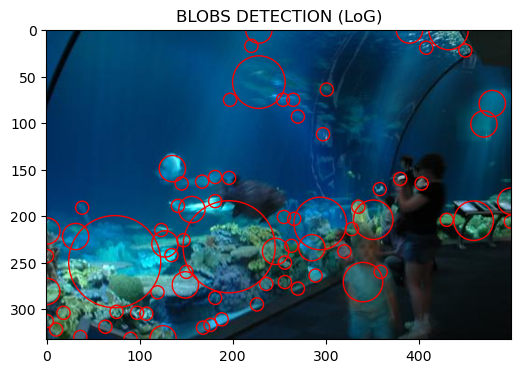

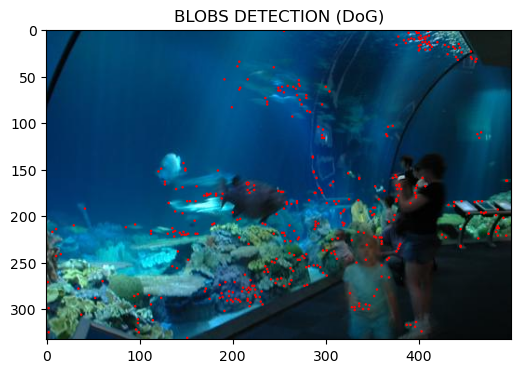

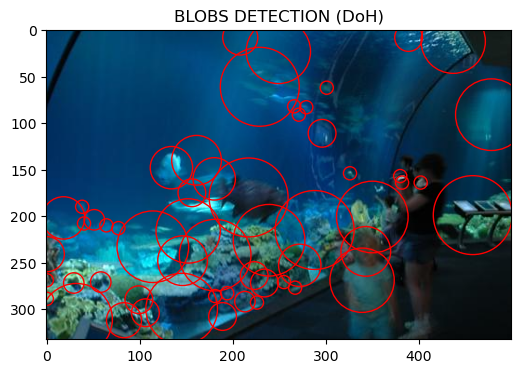

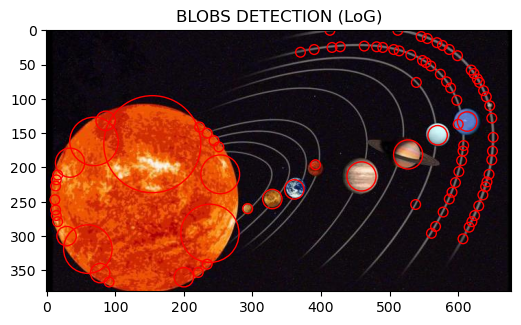

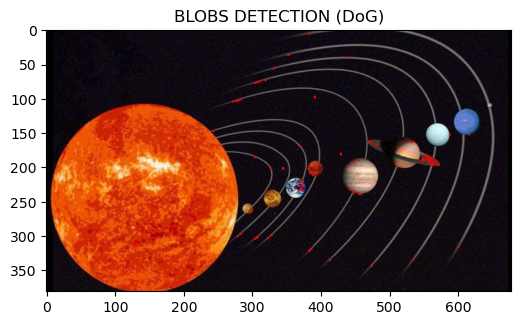

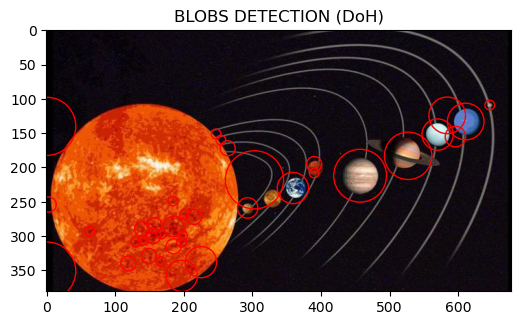

In [10]:
from skimage.feature import blob_dog, blob_log, blob_doh
images = ["dataset/train/aquarium/sun_akcmnzygfvynokzd.jpg","solar.jpg"]
for image_path in images:
    if image_path is None:
        print("Image not found")
    else:
        image1 = cv2.imread(f"{image_path}", cv2.IMREAD_COLOR)
        image1 = cv2.cvtColor(image1,cv2.COLOR_BGR2RGB)
        image = cv2.imread(f"{image_path}", cv2.IMREAD_GRAYSCALE)
        #convert to binary
        ret,binary = cv2.threshold(image,70,255,0)
        blobs = blob_log(binary, min_sigma=5)
        fig, ax = plt.subplots(figsize=(6,6))
        ax.imshow(image1)
        ax.set_title("BLOBS DETECTION (LoG)")
        for blob in blobs:
            y, x, area = blob
            ax.add_patch(plt.Circle((x, y), area*np.sqrt(2), 
                        color='r', fill=False))
        blobs = blob_dog(binary, min_sigma=0.1)
        fig, ax = plt.subplots(figsize=(6,6))
        ax.imshow(image1)
        ax.set_title("BLOBS DETECTION (DoG)")
        for blob in blobs:
            y, x, area = blob
            ax.add_patch(plt.Circle((x, y), area*np.sqrt(2), 
                        color='r', fill=False))
        blobs = blob_doh(binary, min_sigma=5)
        fig, ax = plt.subplots(figsize=(6,6))
        ax.imshow(image1)
        ax.set_title("BLOBS DETECTION (DoH)")
        for blob in blobs:
            y, x, area = blob
            ax.add_patch(plt.Circle((x, y), area*np.sqrt(2), 
                        color='r', fill=False))


### Exercise 3: Normalized Color Histogram and Color Space Changes
**Objective**:
Implement normalized color histograms and explore color space transformations' impact on feature extraction.

**Guideline**:
- Implement normalized color histograms.
- Transform images into different color spaces and generate histograms.
- Analyze the impact of color space changes.

**Expected Results**:
- Color histograms in various spaces for a set of images.
- Comparative analysis on color space impact.
- Discussion on color in feature extraction and analysis.



In [17]:
def normalized_histogram(image, bins=32):
    hist = cv2.calcHist([image], [0, 1, 2], None, [bins, bins, bins], [0, 256, 0, 256, 0, 256])
    hist = hist / hist.sum()  #Normalize the histogram
    return hist.flatten()

def visualize_histograms(image,hist,title):
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    #Plot image
    axes[0].imshow(image, cmap='gray')
    axes[0].set_title("Image")
    axes[0].axis("off")
    #Plot histogram
    axes[1].plot(hist, color='b')
    axes[1].set_title(title)
    axes[1].set_xlabel('Bin Value')
    axes[1].set_ylabel('Frequency')

    plt.tight_layout()
    plt.show()
def visualize_color_histo(image):
    # Get RGB data from image 
    blue_color = cv2.calcHist([image], [0], None, [256], [0, 256]) 
    red_color = cv2.calcHist([image], [1], None, [256], [0, 256]) 
    green_color = cv2.calcHist([image], [2], None, [256], [0, 256]) 

    # Normalize the histograms
    total_pixels = image.shape[0] * image.shape[1]
    blue_color = blue_color / total_pixels
    red_color = red_color / total_pixels
    green_color = green_color / total_pixels

    plt.title("Normalized graph of all RGB Colors") 
    plt.plot(blue_color, color="blue", label='Blue') 
    plt.plot(green_color, color="green", label='Green') 
    plt.plot(red_color, color="red", label='Red') 
    plt.legend(loc='upper right')
    plt.show() 

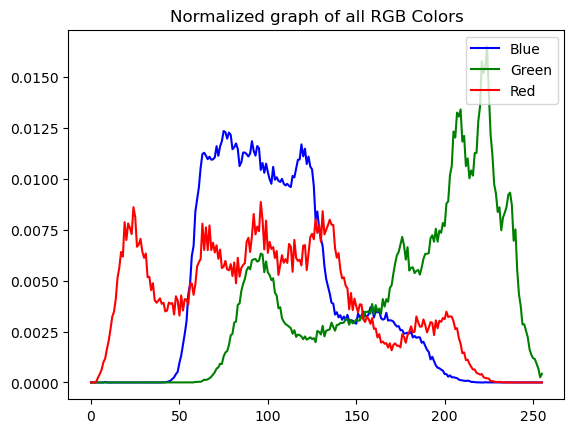

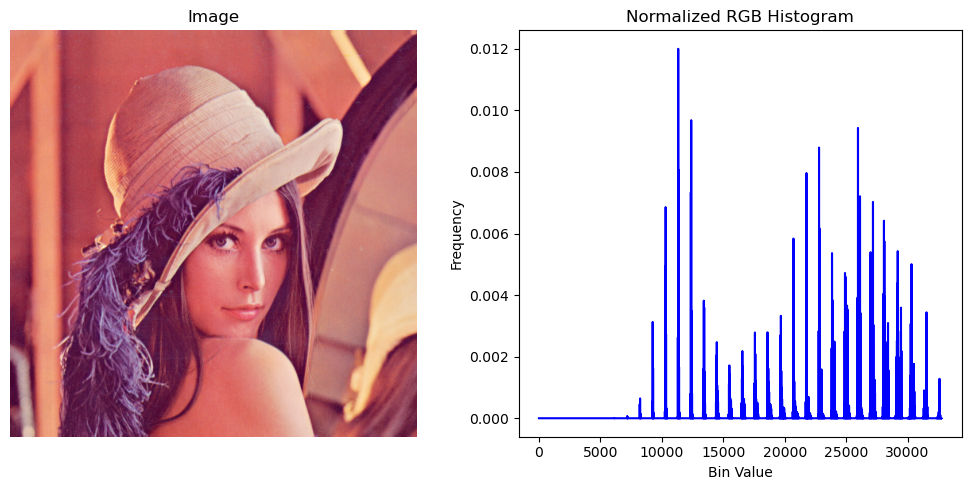

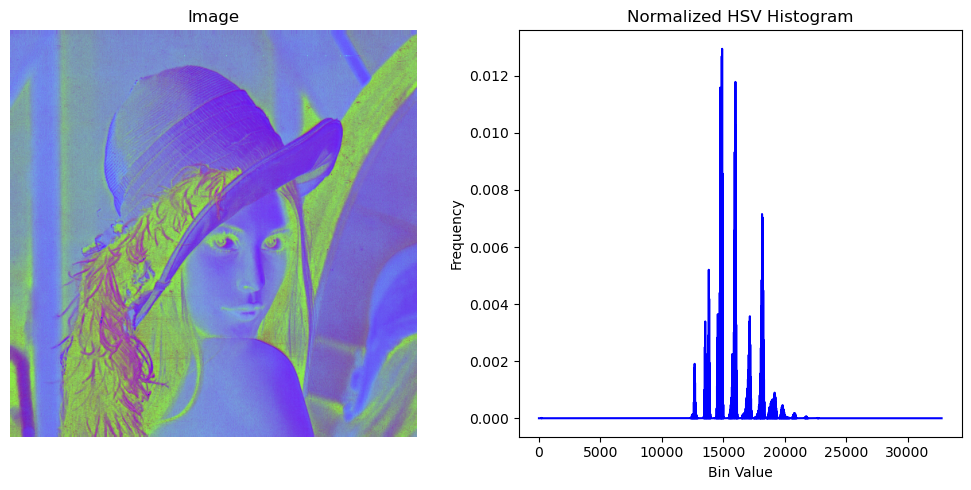

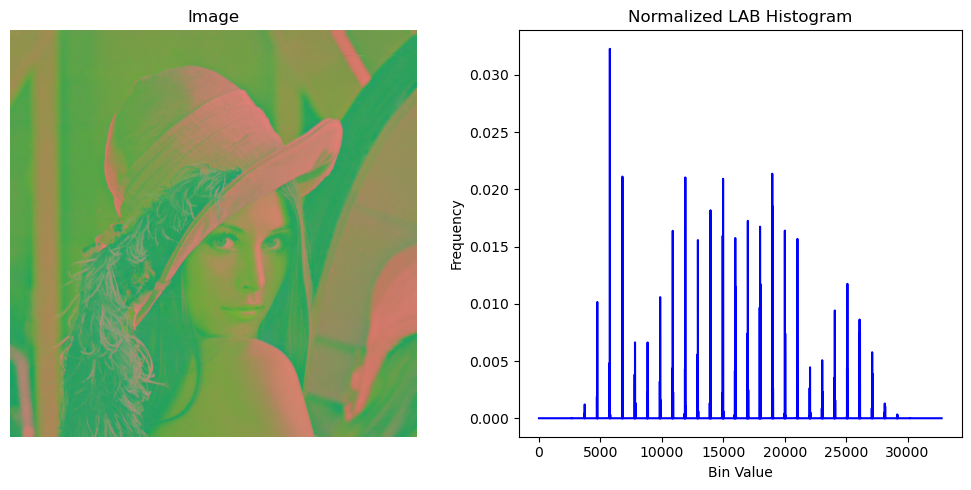

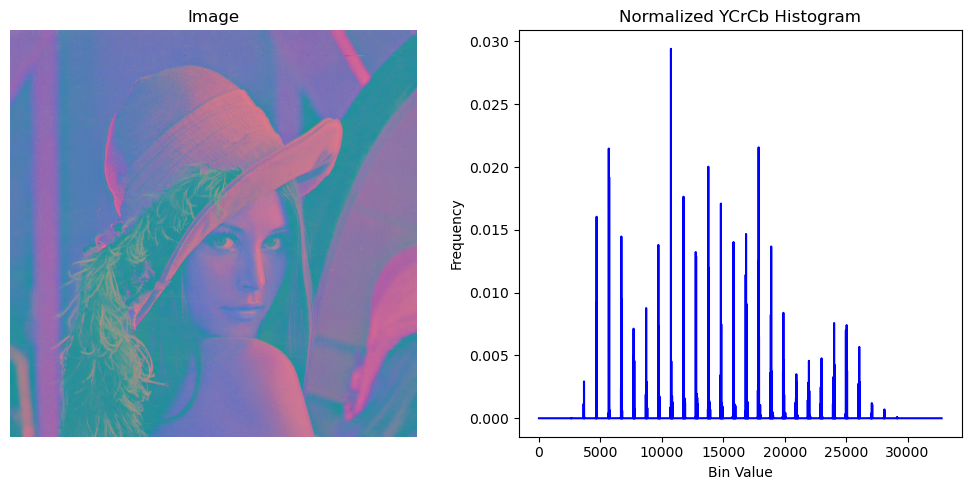

...

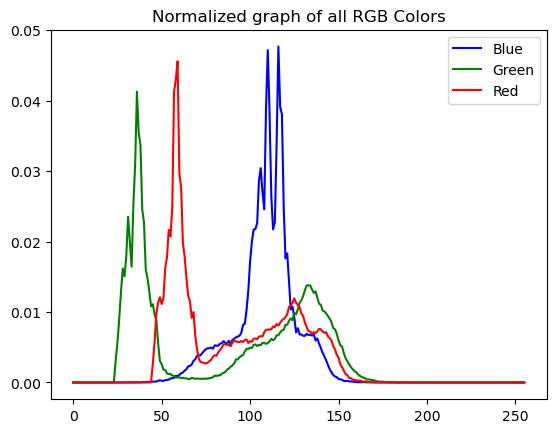

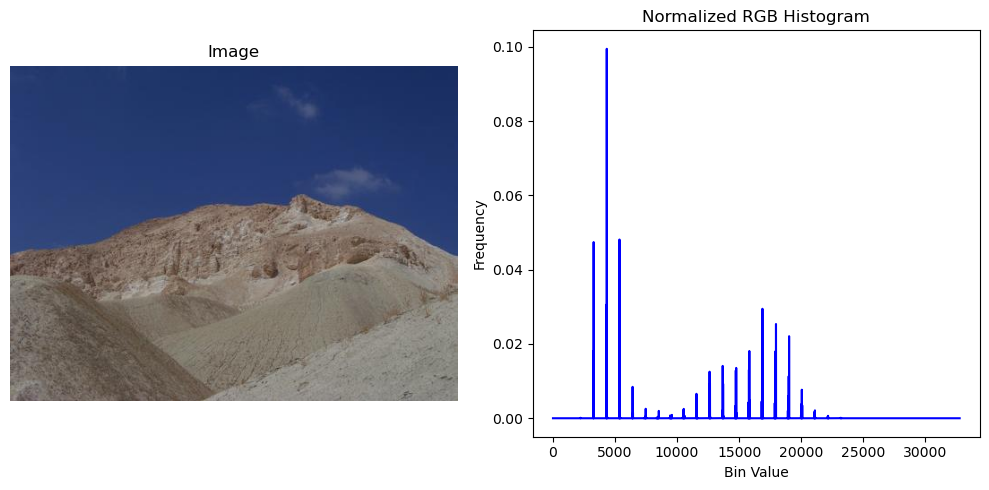

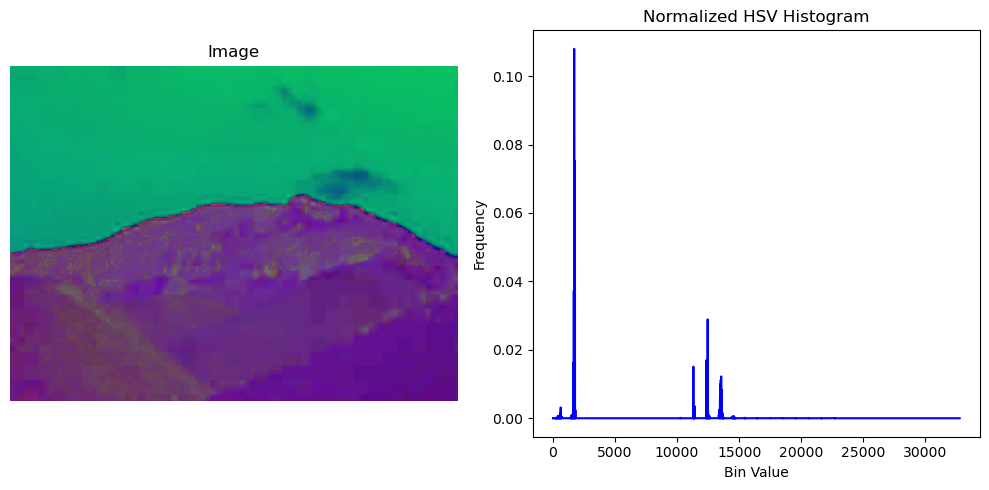

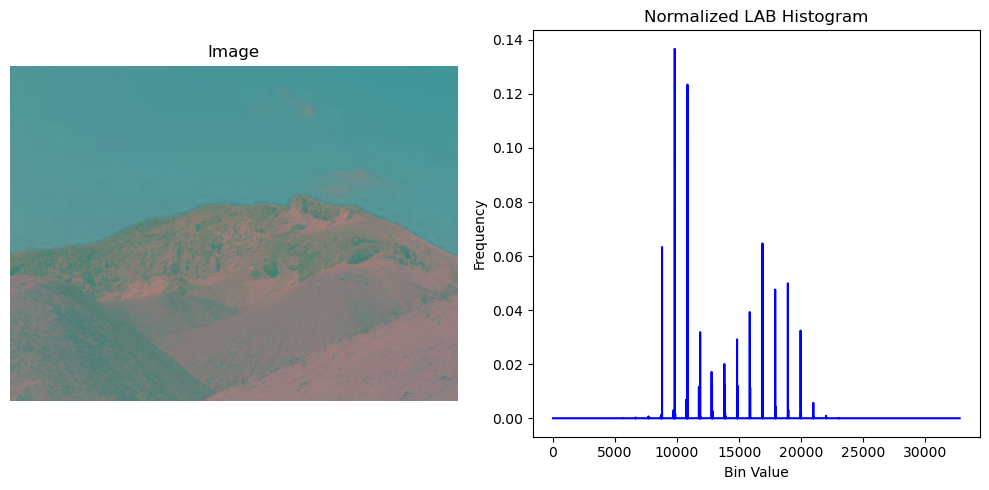

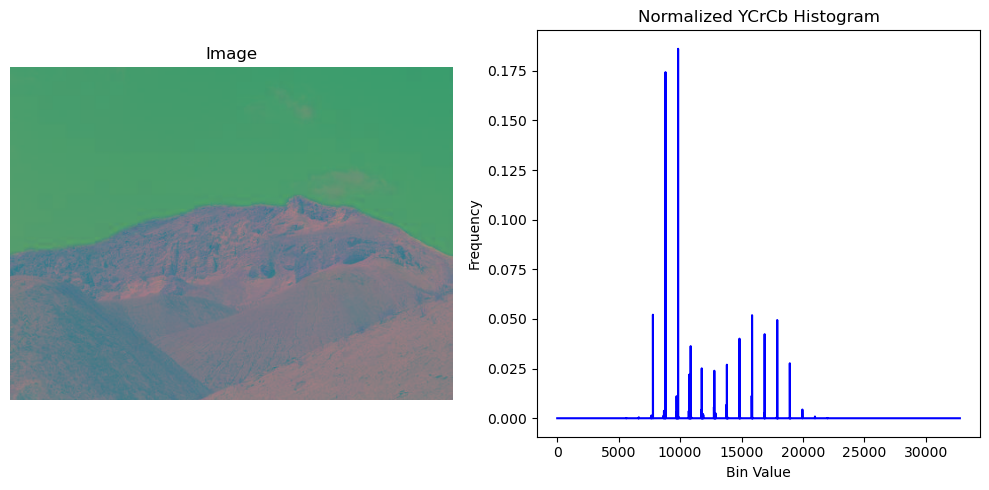

In [18]:
images = [cv2.imread("lenna.png"),
          cv2.imread("dataset/train/aquarium/sun_acqtrbkcyyyjbqty.jpg"),
          cv2.imread("dataset/train/desert/sun_adjlepvuitklskrz.jpg")]

for image in images:
    if image is not None:
        # load image 
        imageObj = image  
        visualize_color_histo(imageObj)    
        
        conversions = [cv2.cvtColor(image, cv2.COLOR_BGR2RGB),
                       cv2.cvtColor(image, cv2.COLOR_RGB2HSV),
                       cv2.cvtColor(image, cv2.COLOR_RGB2LAB),
                       cv2.cvtColor(image, cv2.COLOR_RGB2YCrCb)]
        titles = ["Normalized RGB Histogram",
                  "Normalized HSV Histogram",
                  "Normalized LAB Histogram",
                  "Normalized YCrCb Histogram"]
        
        for converted_image,title in zip(conversions,titles):
            hist = normalized_histogram(converted_image)
            visualize_histograms(converted_image,hist,title)            
    else:
        print("Image not found.")
  



### Discussion on Color in Feature Extraction and Analysis
- RGB vs. Other Color Spaces: RGB is commonly used, but other color spaces like HSV, LAB, and YCrCb can capture information differently. For example, HSV separates color information from intensity, making it useful for certain applications.

- Impact on Feature Extraction: Different color spaces may highlight different aspects of an image. For instance, LAB may be more sensitive to color variations, while YCrCb might be useful for skin tone detection. Understanding the nature of your data and the features you're interested in is crucial.

- Normalization: Normalizing histograms is essential for making them invariant to changes in image size and intensity. It ensures that the distribution of color information is comparable across different images.

- Application Specifics: The choice of color space depends on the specific application. For image retrieval, you might prefer a color space that is more robust to changes in lighting. For skin detection, a color space that separates chromatic information could be beneficial.

In conclusion, exploring and understanding different color spaces and their impact on feature extraction is crucial for choosing the most suitable color representation for a given application.

### Exercise 4: Implementation and Analysis of SIFT, SURF, and ORB
**Objective**:
Implement and analyze SIFT, SURF, and ORB feature descriptors (use opencv implementations), understanding their pros and cons.

**Guideline**:
- Select a diverse image dataset.
- Implement SIFT and ORB algorithms. (Since SURF is patented, is optionally in the comparions)
- Apply these methods to some images.

**Expected Results**:
- Implementations of SIFT, ORB (and SURF).
- Hyperparameter analysis of each algorithm.
- Comparision of the methods

In [3]:
import os
import time
import seaborn as sns

Number of images in the dataset: 5


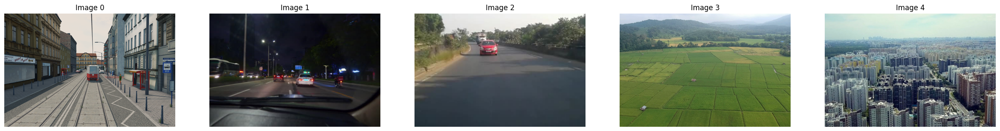

In [4]:
#IMPORT DATASET
def load_images(dataset_path):
    """
    Load images from the dataset and store them in a list.

    Input: dataset_path, str.
    Output: images, list of images.
    """
    images = []
    if os.path.isdir(dataset_path):
        for image_file in os.listdir(dataset_path):
            image_path = os.path.join(dataset_path, image_file)
            if image_file.endswith((".jpg", ".jpeg", ".png")):
                # Load image
                image = cv2.imread(image_path)
                # Convert BGR to RGB (OpenCV loads images in BGR format)
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                images.append(image)
    return images

a = load_images("dataset2/normal/")

if not a:
    print("Dataset is empty.")
else:
    print(f"Number of images in the dataset: {len(a)}")
    fig, axes = plt.subplots(1, len(a), figsize=(30, 20))
    for i in range(len(a)):
        axes[i].imshow(a[i], cmap='gray')
        axes[i].set_title(f"Image {i}")
        axes[i].axis("off")


### 4.1. ALGORITHM IMPLEMENTATION

#### 4.1.1. SIFT

In [34]:
def sift(image, nfeatures=0, contrastThresh=0.04, edgeThresh=10):
    # Initialize SIFT detector
    sift = cv2.SIFT_create(nfeatures=nfeatures, contrastThreshold=contrastThresh, edgeThreshold=edgeThresh)
    # Find keypoints and descriptors
    keypoints, descriptors = sift.detectAndCompute(image, None)

    return keypoints, descriptors

Hyperparameter analysis of SIFT

- nfeatures: number of best features to retain, ranked by their scores measured by local contrast. (default = 0, keeps all features)
- nOctaveLayers: number of layers in each octave, which is automatically computed from image resolution. (default = 3)
- contrastThreshold: below this threshold a keypoint is discarded. (default = 0.04)
- edgeThreshold: threshold to filter out edge-like features. Higher = more features are retained.(default = 10)

Pros and cons of SIFT:

Pros:

- Scale Invariance: SIFT features are invariant to image scale, making them robust to changes in the size of objects in an image.
- Rotation Invariance: SIFT features can handle image rotations, providing robustness to changes in orientation.
- Distinctiveness: SIFT features are distinctive and can be matched reliably even in the presence of occlusions and changes in illumination.

Cons:
- Computational Cost: SIFT is computationally expensive, especially in terms of memory requirements and processing time.


#### 4.1.2. SURF

In [35]:
def surf(image):
    # Initialize SURF detector
    surf = cv2.xfeatures2d.SURF_create()
    # Find keypoints and descriptors
    keypoints, descriptors = surf.detectAndCompute(image, None)
    
    return keypoints, descriptors

Hyperparameter analysis of SURF

- hessianThreshold: threshold for hessian keypoint detector. Higher values = fewer keypoints.
- nOctaves: number of octaves to be used by the detector. Higher values = detect keypoints at different scales.
- nOctaveLayers: number of layers within each octave. Adjusting this can influence keypoint detection and descriptor quality.

Pros and cons of SURF

Pros:
- Speed: SURF is designed to be faster than SIFT, making it more suitable for real-time applications.
- Scale and Rotation Invariance: Similar to SIFT, SURF features are invariant to scale and rotation changes.

Cons:
- Less Distinctive: While SURF is faster, its features may be less distinctive compared to SIFT in some cases.
- Patented: some variations of SURF were patented.

#### 4.1.3. ORB

In [36]:
def orb(image, nfeatures=500, scaleFactor=1.2, nlevels=8):
    # Initialize ORB detector
    orb = cv2.ORB_create(nfeatures=nfeatures, scaleFactor=scaleFactor, nlevels=nlevels)
    # Find keypoints and descriptors
    keypoints, descriptors = orb.detectAndCompute(image, None)
    
    return keypoints, descriptors

Hyperparameter analysis of ORB

- nfeatures: controls the number of keypoints to retain.
- scaleFactor: pyramid decimation ratio, determines the number of pyramid levels. Smaller values = more keypoints.
- nlevels: The number of pyramid levels. More levels can capture more information but may increase computation time.

Pros and cons of ORB:

Pros:
- Speed: ORB is designed for efficiency and is faster than both SIFT and SURF.
- Binary Feature Descriptors: ORB uses binary feature descriptors, making it memory-efficient and suitable for resource-constrained applications.
- Open Source: ORB is open-source and free to use without patent restrictions.

Cons:
- Limited Rotation Invariance: ORB provides some level of rotation invariance but may not be as robust as SIFT or SURF in handling large rotations.
- Less Distinctive: Similar to SURF, ORB features may be less distinctive compared to SIFT.

### 4.2. COMPARISON OF THE METHODS
Based on:
- Comparing keypoints of each algorithm in same image.
- Altering hyperparameters to obtain better results.

In [37]:
lenna = cv2.imread("lenna.png")
lenna = cv2.cvtColor(lenna, cv2.COLOR_BGR2RGB)
a.append(lenna)

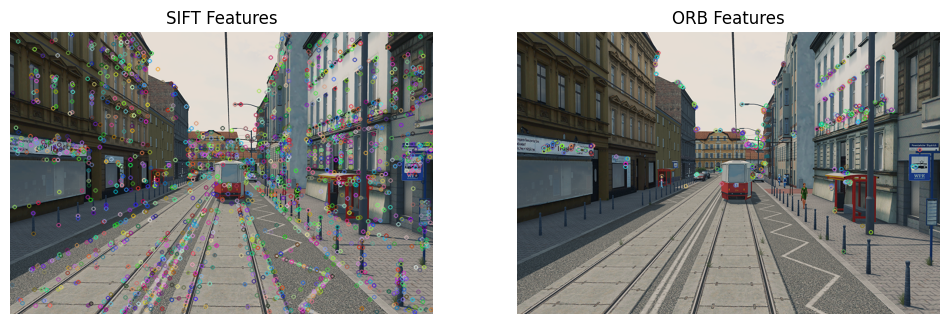

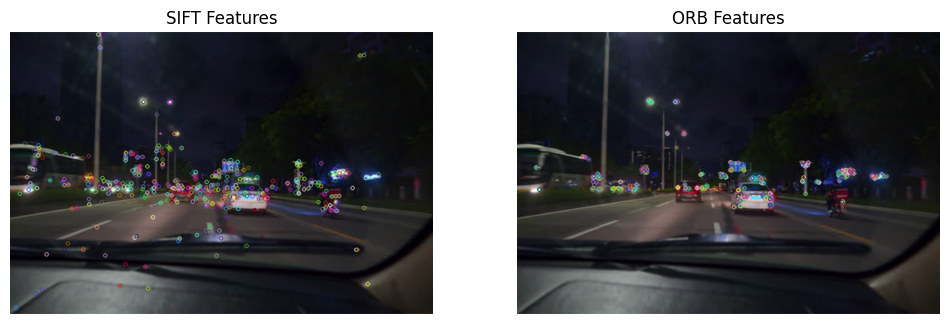

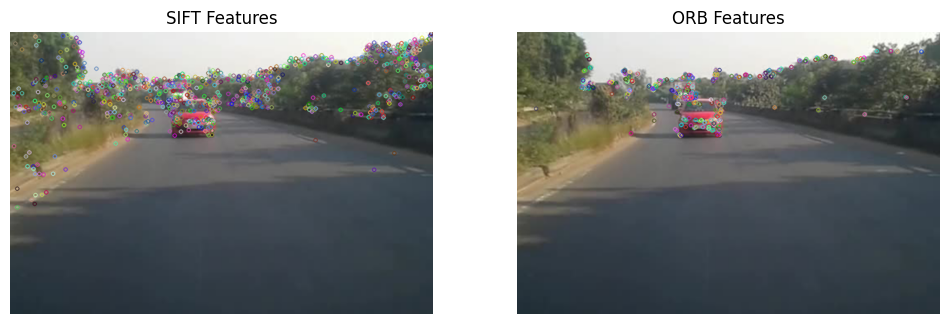

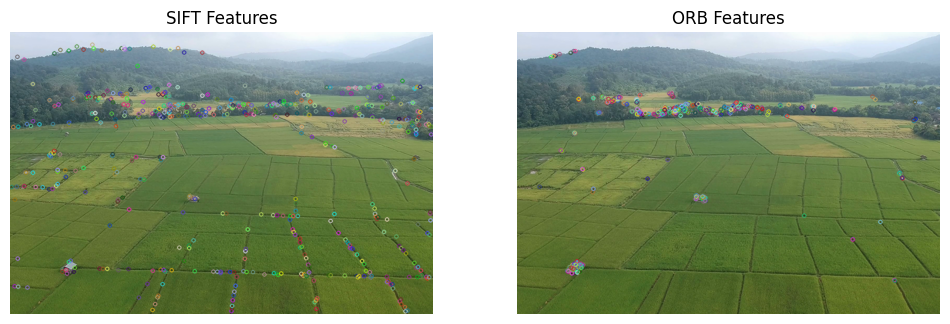

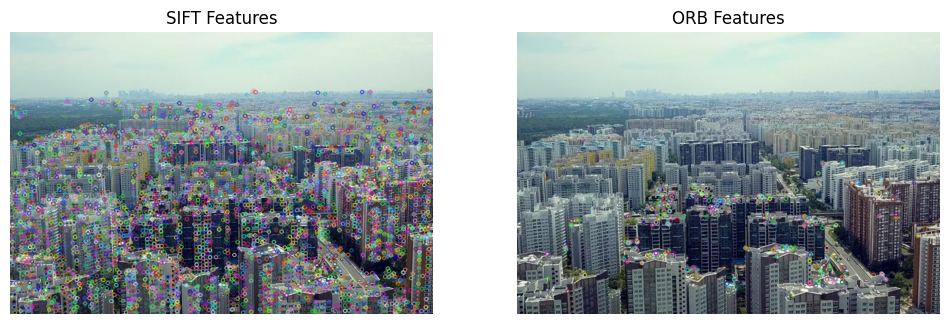

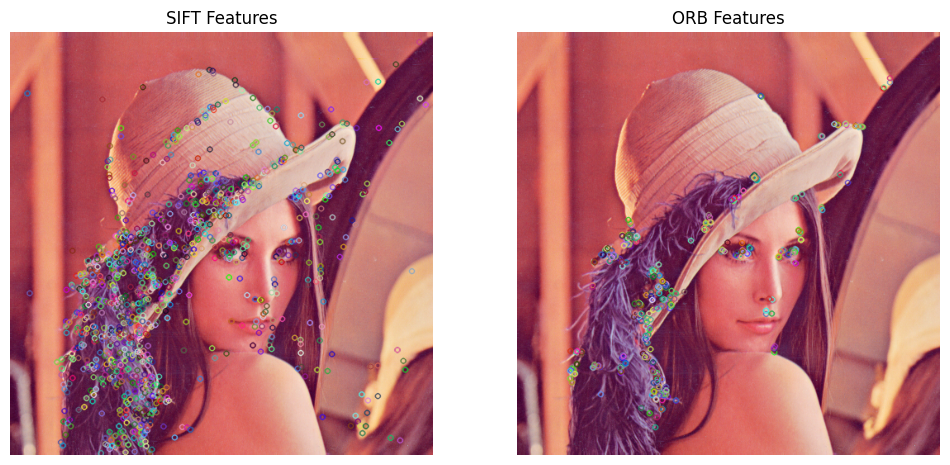

In [38]:
#Apply SIFT and ORB to the images in the dataset with default values

for img in a:
    keypoints_sift, descriptors_sift = sift(img, nfeatures=0, contrastThresh=0.04, edgeThresh=10)
    keypoints_orb, descriptors_orb = orb(img, nfeatures=500, scaleFactor=1.2, nlevels=8)

    # Display the keypoints on the image
    img_sift = cv2.drawKeypoints(img, keypoints_sift, None)
    img_orb = cv2.drawKeypoints(img, keypoints_orb, None)

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1), plt.imshow(img_sift), plt.title('SIFT Features'), plt.axis("off")
    plt.subplot(1, 2, 2), plt.imshow(img_orb), plt.title('ORB Features'), plt.axis("off")
    plt.show()

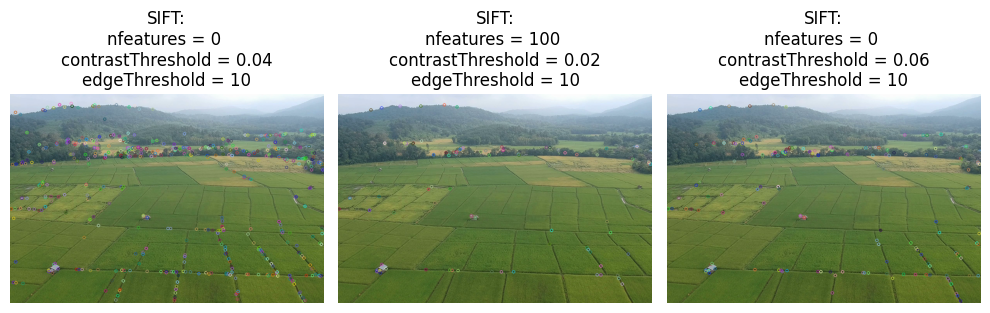

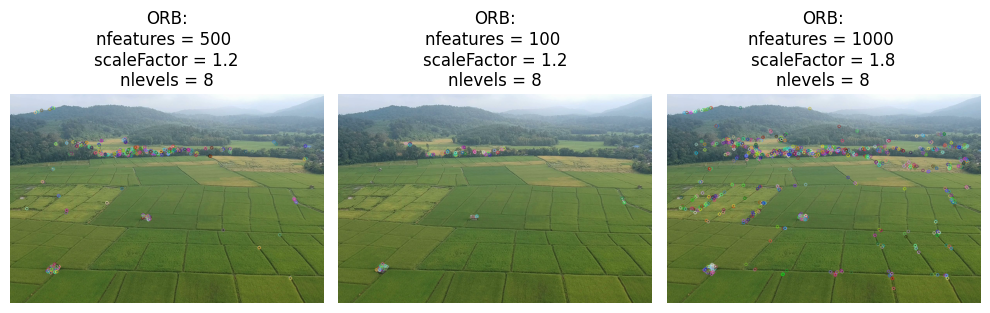

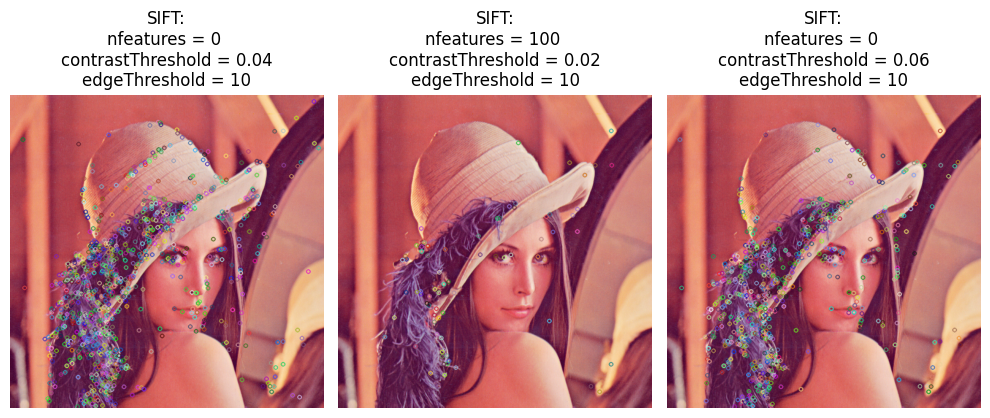

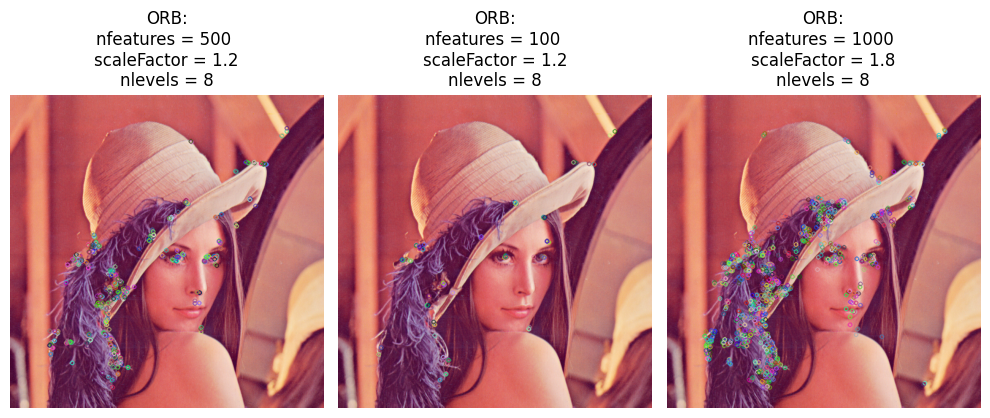

In [39]:
#Apply different hyperparameters of SIFT and ORB to an image and compare

for img in [a[3], a[-1]]:
    #SIFT
    sift_images = []
    titles = []

    for p1,p2,p3 in ([0,0.04,10],[100,0.02,10],[0,0.06,10]):
        kp_sift, des_sift = sift(img, nfeatures=p1, contrastThresh=p2, edgeThresh=p3)
        sift_images.append(cv2.drawKeypoints(img, kp_sift, None))
        titles.append(f"SIFT:\nnfeatures = {p1} \ncontrastThreshold = {p2}\nedgeThreshold = {p3}")

    visualize(sift_images,titles,None,None)

    #ORB
    orb_images = []
    titles = []

    for p1,p2,p3 in([500,1.2,8],[100,1.2,8],[1000,1.8,8]):
        kp_orb, des_orb = orb(img, nfeatures=p1, scaleFactor=p2, nlevels=p3)
        orb_images.append(cv2.drawKeypoints(img, kp_orb, None))
        titles.append(f"ORB:\nnfeatures = {p1} \nscaleFactor = {p2}\nnlevels = {p3}")

    visualize(orb_images,titles,None,None)


### (Optional) Exercise 4.5: Implement other image descriptor methods (motion, shape, ...)


#### 4.5.1 FAST (Features from Accelerated Segment Image)

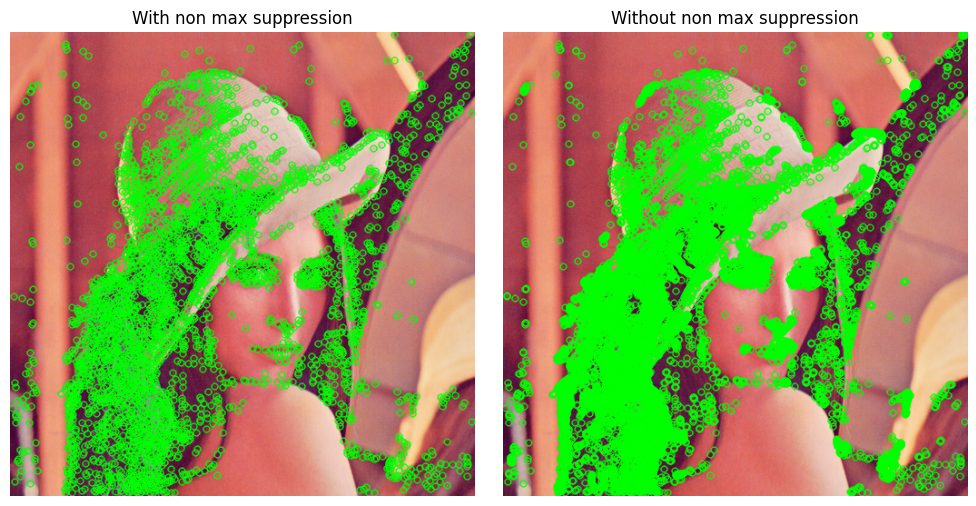

Number of Keypoints Detected In The Image With Non Max Suppression:  3602
Number of Keypoints Detected In The Image Without Non Max Suppression 11878


In [40]:
#APPLY FAST ALGORITHM TO IMAGE
def fast(image):
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

    fast = cv2.FastFeatureDetector_create() 

    #Detect keypoints with non max suppression
    keypoints_with_nonmax = fast.detect(gray, None)

    #Disable nonmaxSuppression 
    fast.setNonmaxSuppression(False)

    #Detect keypoints without non max suppression
    keypoints_without_nonmax = fast.detect(gray, None)

    image_with_nonmax = np.copy(image)
    image_without_nonmax = np.copy(image)

    #Draw keypoints on top of the input image
    cv2.drawKeypoints(image, keypoints_with_nonmax, image_with_nonmax, color=(0,255,0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    cv2.drawKeypoints(image, keypoints_without_nonmax, image_without_nonmax, color=(0,255,0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

    #Display image with and without non max suppression
    visualize([image_with_nonmax,image_without_nonmax],["With non max suppression","Without non max suppression"],None,None)

    #Print the number of keypoints detected in the training image
    print("Number of Keypoints Detected In The Image With Non Max Suppression: ", len(keypoints_with_nonmax))

    #Print the number of keypoints detected in the query image
    print("Number of Keypoints Detected In The Image Without Non Max Suppression",len(keypoints_without_nonmax))

image = cv2.imread("lenna.png")
fast(image)

#### 4.5.1 BRIEF (Binary Robust Independent Elementary Features)

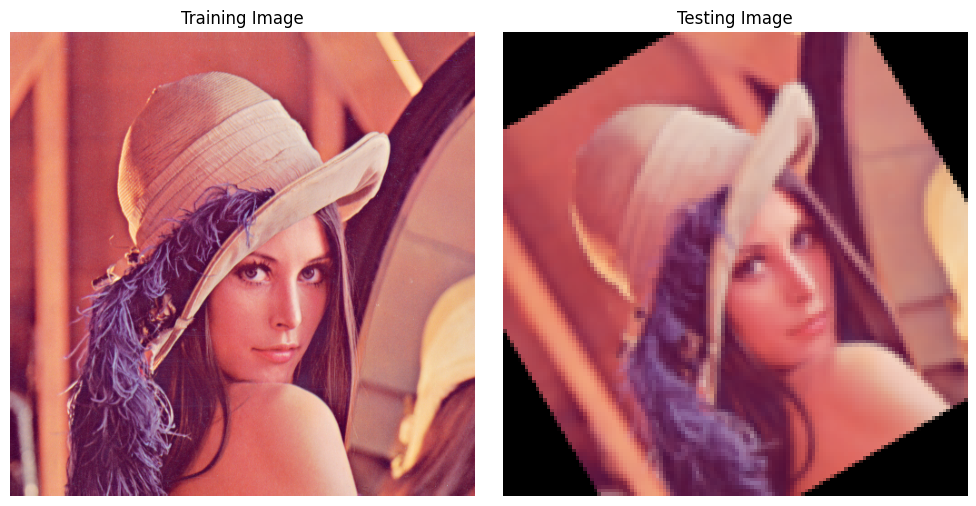

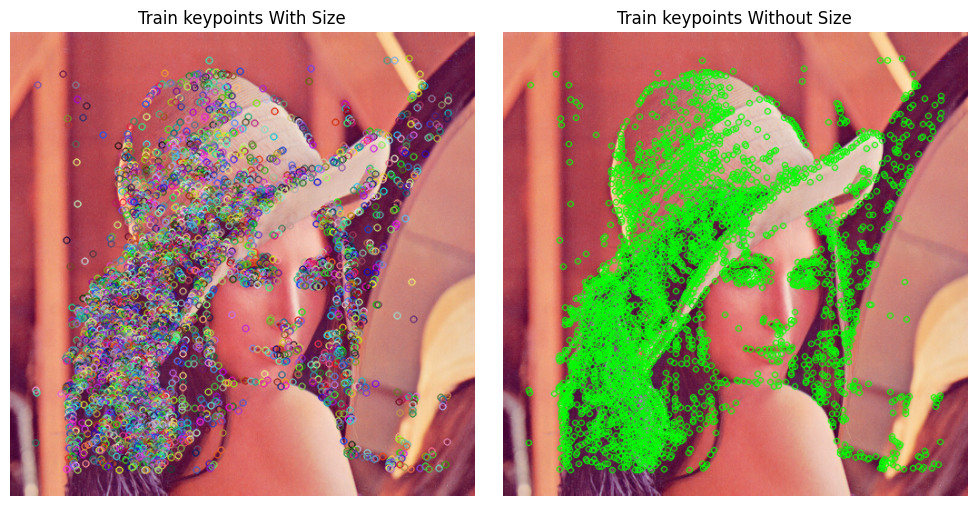

Number of Keypoints Detected In The Training Image:  3311
Number of Keypoints Detected In The Query Image:  141


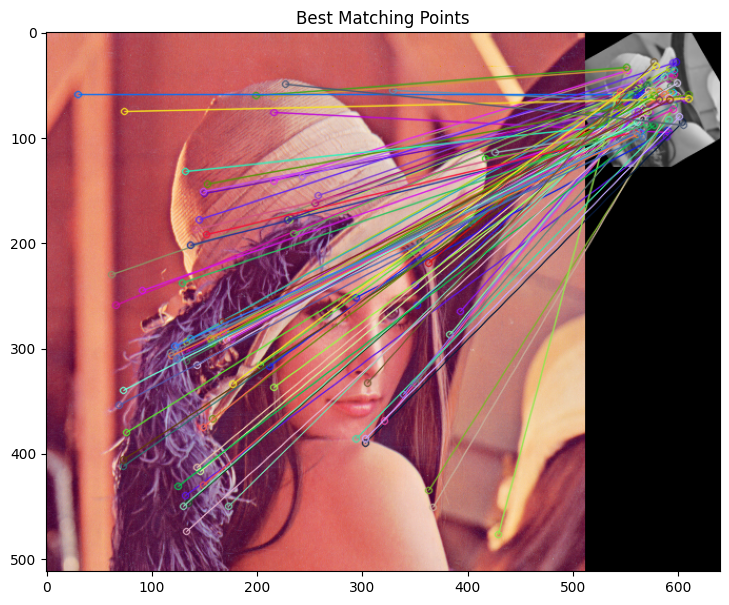


Number of Matching Keypoints Between The Training and Query Images:  88


In [41]:
#APPLY BRIEF ALGORITHM TO IMAGE
def brief(image):
    # Convert the training image to RGB and to greyscale
    training_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    training_gray = cv2.cvtColor(training_image, cv2.COLOR_RGB2GRAY)

    # Create test image by adding Scale Invariance and Rotational Invariance
    test_image = cv2.pyrDown(training_image)
    test_image = cv2.pyrDown(test_image)
    num_rows, num_cols = test_image.shape[:2]

    rotation_matrix = cv2.getRotationMatrix2D((num_cols/2, num_rows/2), 30, 1)
    test_image = cv2.warpAffine(test_image, rotation_matrix, (num_cols, num_rows))

    test_gray = cv2.cvtColor(test_image, cv2.COLOR_RGB2GRAY)

    fast = cv2.FastFeatureDetector_create() 
    brief = cv2.xfeatures2d.BriefDescriptorExtractor_create()

    train_keypoints = fast.detect(training_gray, None)
    test_keypoints = fast.detect(test_gray, None)

    train_keypoints, train_descriptor = brief.compute(training_gray, train_keypoints)
    test_keypoints, test_descriptor = brief.compute(test_gray, test_keypoints)

    keypoints_without_size = np.copy(training_image)
    keypoints_with_size = np.copy(training_image)

    cv2.drawKeypoints(training_image, train_keypoints, keypoints_without_size, color = (0, 255, 0))
    cv2.drawKeypoints(training_image, train_keypoints, keypoints_with_size, flags = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    
    # Visualization
    visualize([training_image,test_image],["Training Image","Testing Image"],None,None)
    visualize([keypoints_with_size,keypoints_without_size],["Train keypoints With Size","Train keypoints Without Size"],None,None)
    
    print("Number of Keypoints Detected In The Training Image: ", len(train_keypoints))
    print("Number of Keypoints Detected In The Query Image: ", len(test_keypoints))

    # Create a Brute Force Matcher object.
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck = True)

    # Perform the matching between the BRIEF descriptors of the training image and the test image
    matches = bf.match(train_descriptor, test_descriptor)

    # The matches with shorter distance are the ones we want.
    matches = sorted(matches, key = lambda x : x.distance)

    result = cv2.drawMatches(training_image, train_keypoints, test_gray, test_keypoints, matches, test_gray, flags = 2)

    # Display the best matching points
    plt.rcParams['figure.figsize'] = [14.0, 7.0]
    plt.title('Best Matching Points')
    plt.imshow(result)
    plt.show()

    # Print total number of matching points between the training and query images
    print("\nNumber of Matching Keypoints Between The Training and Query Images: ", len(matches))


image = cv2.imread("lenna.png")
brief(image)



### Exercise 5: Bag of Visual Words Pipeline and VOC Dataset Analysis
**Objective**:
Develop a BoVW model and apply it to classify images from the VOC dataset, focusing on the BoVW approach.

**Guideline**:
- Load the VOC dataset.
- Implement the BoVW model.
- Apply the model to the dataset for classification.
- Evaluate the model's performance.

**Expected Results**:
- Implementation of the Bag of Visual Words model.
- Application of the model for image classification.
- Evaluation of the model's performance.

**Optional Enhancements**:
- Experiment with different clustering algorithms for codebook generation in the BoVW model.

### Step 1: Data Loading
- **Objective**: Load images from each class into a format suitable for processing.
- **Guide**: Use a library like OpenCV or PIL in Python to load images. Iterate over the folders, loading each image and storing it with its class label.

In [121]:
import cv2
import os
from sklearn.cluster import KMeans

def load_images(dataset_path):
    """
    Load images from the dataset and store them in a list.

    Input: dataset_path, str.
    Output: images, list of images.
            labels, list of labels of the correponding images.
    """
    images = []
    labels = []

    for class_folder in os.listdir(dataset_path):
        class_path = os.path.join(dataset_path, class_folder)
        if os.path.isdir(class_path):
            for image_file in os.listdir(class_path):
                image_path = os.path.join(class_path, image_file)
                if image_file.endswith((".jpg", ".jpeg", ".png")):
                    # Load image
                    image = cv2.imread(image_path)
                    # Convert BGR to RGB (OpenCV loads images in BGR format)
                    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                    images.append(image)
                    labels.append(class_folder)

    return images, labels

In [122]:
def numericalLabels(labels):
    """
    Transform list of labels of images to a list of floats.

    Input: labels, list of categorical labels of images. Lenght = number of images.
    Output: num_labels, ndarray of numerical labels of images. Lenght = number of images.
    """
    num_labels = np.array([])
    label_names = list(set(labels))
    label_count = len(label_names)

    for label in labels:
        for i in range(label_count):
            if label == label_names[i]:
                class_index = i

        num_labels = np.append(num_labels, class_index)

    return num_labels

from collections import Counter

def SamplesXClass(labels):
    """ 
    Counts how many samples of each class there are.

    Input: labels, list of categorical labels of images. Lenght = number of images.
    Output: samplesXclass, list of counts of samples of each class. Lenght = number of classes.
    """
    #Count occurrences of each class
    class_counts = Counter(labels)
    #Create an array of counts based on the order of classes
    samplesXclass = [class_counts.get(class_name, 0) for class_name in set(labels)]
    return samplesXclass

def plotClassCollage(images, labels, class_names, num_images_per_class=10):
    """ 
    Plot to show samples of each class.

    Input:
        - images: list of images.
        - labels: list of categorical labels of images. Lenght = number of images.
        - class_names: list of unique categorical labels of images. Lenght = number of classes.
        - num_images_per_class: int, number of images to show x class.
    """
    plt.figure(figsize=(15, 15))
    class_counts = {class_name: 0 for class_name in class_names}

    for img, label in zip(images, labels):
        class_name = class_names[int(label)]  # Convert label to integer before using as an index
        if class_counts[class_name] < num_images_per_class:
            plt.subplot(len(class_names), num_images_per_class, class_names.index(class_name) * num_images_per_class + class_counts[class_name] + 1)
            plt.imshow(img, cmap='gray')
            plt.title(f"{class_name} - {class_counts[class_name] + 1}")
            plt.axis('off')
            class_counts[class_name] += 1

    plt.show()

Number of images in the TRAIN dataset: 640
Labels: {'park', 'laundromat', 'kitchen', 'windmill', 'highway', 'desert', 'waterfall', 'aquarium'}
Number of images in the TEST dataset: 160
Labels: {'park', 'laundromat', 'kitchen', 'windmill', 'highway', 'desert', 'waterfall', 'aquarium'}
NUMBER OF CLUSTERS: 80
NUMBER OF CLASSES: 8
NUMBER OF SAMPLES X CLASS [80, 80, 80, 80, 80, 80, 80, 80]


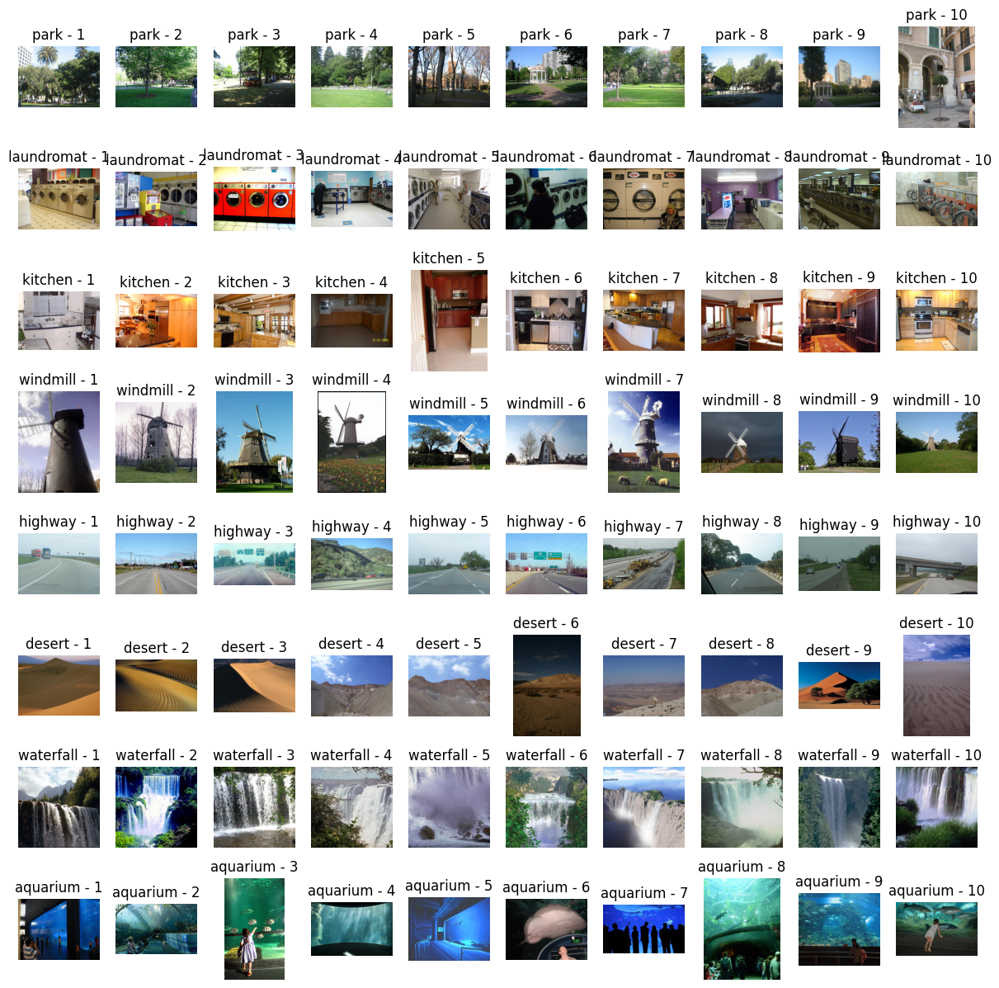

In [123]:
images, labels = load_images("dataset/train/")
test_images, true_labels = load_images("dataset/test/")

if not images:
    print("Dataset is empty.")
else:
    print(f"Number of images in the TRAIN dataset: {len(images)}")
    print(f"Labels: {set(labels)}")

if not test_images:
    print("Dataset is empty.")
else:
    print(f"Number of images in the TEST dataset: {len(test_images)}")
    print(f"Labels: {set(true_labels)}")

#GLOBAL VARIABLES 
N_CLUSTERS = len(set(labels)) * 10
IMAGE_COUNT = len(images)
N_CLASSES = len(set(labels))
SAMPLES_X_CLASS = SamplesXClass(labels) #List of number of samples x class (lenght = N_CLASSES)

print(f"NUMBER OF CLUSTERS: {N_CLUSTERS}")
print(f"NUMBER OF CLASSES: {N_CLASSES}")
print(f"NUMBER OF SAMPLES X CLASS {SAMPLES_X_CLASS}")

#Convert categorical labels to numerical
train_labels = numericalLabels(labels)
test_labels = numericalLabels(true_labels)

#Plot images in each class to see what we are working for
plotClassCollage(images, train_labels, list(set(labels)), num_images_per_class=10)

### Step 2: Feature Extraction
- **Objective**: Extract features from each image to represent its content.
- **Guide**: Apply a feature descriptor to each image. This transforms the image into a set of features. Examples can be SIFT, SURF, Color histogram, etc

In [124]:
def extract_descriptors(images):
    """
    Extract SIFT descriptors from a list of images.

    Input: images, list of images.
    Output: descriptors_list, list of SIFT descriptors
    """
    sift = cv2.SIFT_create()
    descriptors_list = []

    for img in images:
        keypoints, descriptors = sift.detectAndCompute(img, None)
        descriptors_list.append(descriptors) #New code
        #descriptors_list.extend(descriptors) #Flat list

    descriptors = np.array(descriptors_list[0]) #New code
    for descriptor in descriptors_list[1:]:
        descriptors = np.vstack((descriptors, descriptor)) 

    return descriptors, descriptors_list

In [125]:
descriptors, descriptors_list = extract_descriptors(images)
print("Descriptors ready!")

Descriptors ready!


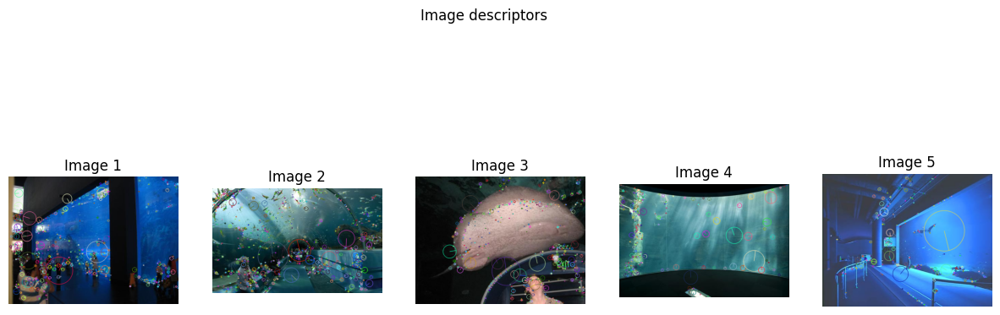

In [126]:
def visualize_descriptors(images, num_columns=5):
    """ 
    Plot image descriptors.

    Input: 
        - images: list of images we want to show its descriptors.
        - num_columns: int, number of columns of the plot.
    """
    num_images = len(images)

    plt.figure(figsize=(15, 5 * (num_images // num_columns + 1)))

    for i, image in enumerate(images, start=1):
        sift = cv2.SIFT_create()
        keypoints, descriptors = sift.detectAndCompute(image, None)

        plt.subplot((num_images // num_columns) + 1, num_columns, i)
        img_with_keypoints = cv2.drawKeypoints(image, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        plt.imshow(img_with_keypoints)
        plt.title(f'Image {i}')
        plt.axis('off')

    plt.suptitle("Image descriptors")
    plt.show()

# Example usage with multiple images
selected_images = [images[0], images[1], images[5], images[3], images[4]]  # Choose 5 images
visualize_descriptors(selected_images)


### Step 3: Building the Vocabulary (Codebook)
- **Objective**: Create a vocabulary of visual words (features) that represents the dataset.
- **Guide**: Cluster the extracted features across all images using any clustering algorithm. Each cluster center is a visual word.

In [127]:
from sklearn.cluster import MiniBatchKMeans

def cluster_descriptors(descriptors, N_CLUSTERS):
    """
    Cluster SIFT descriptors using MiniBatchKMeans and create the codebook.

    Input: descriptor_list, list of SIFT descriptors.
    Output: 
        - kmeans: MiniBatchKMeans model.
        - codebook: 2D numpy array where each row is a cluster center (visual word)
                and columns are features of each center.
    """
    print(f"Number of clusters: {N_CLUSTERS}")
    kmeans = MiniBatchKMeans(n_clusters=N_CLUSTERS, batch_size=100, max_iter=100, verbose=0, n_init=10)
    kmeans.fit(descriptors)
    codebook = kmeans.cluster_centers_
    print(f"Codebook shape: {codebook.shape}")
    
    return kmeans, codebook

In [128]:
kmeans, codebook = cluster_descriptors(descriptors, N_CLUSTERS)
print("Codebook ready!")

Number of clusters: 80
Codebook shape: (80, 128)
Codebook ready!


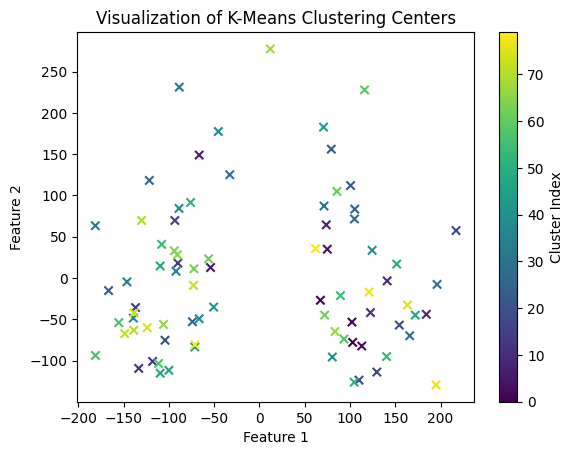

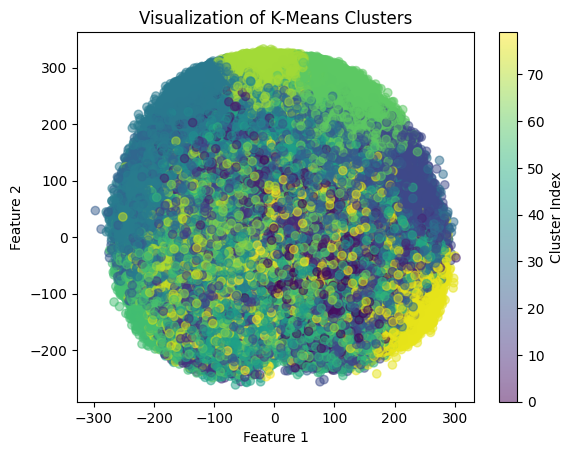

In [129]:
def visualize_kmeans_clusters(kmeans, codebook):
    """
    Visualize the k-means clustering centers.

    Input:
        - kmeans: MiniBatchKMeans model.
        - codebook: 2D numpy array where each row is a cluster center.
    """
    num_clusters = len(codebook)

    # If the descriptors have more than 2 dimensions, use PCA to reduce to 2 dimensions
    if codebook.shape[1] > 2:
        from sklearn.decomposition import PCA
        pca = PCA(n_components=2)
        codebook_2d = pca.fit_transform(codebook)
    else:
        codebook_2d = codebook

    # Scatter plot the clustering centers
    plt.scatter(codebook_2d[:, 0], codebook_2d[:, 1], c=np.arange(num_clusters), cmap='viridis', marker='x')
    plt.title('Visualization of K-Means Clustering Centers')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.colorbar(label='Cluster Index')
    plt.show()

visualize_kmeans_clusters(kmeans,codebook)

def visualize_kmeans_clusters(kmeans, descriptors):
    """
    Visualize the k-means clustering results by creating a scatter plot of descriptors.

    Input:
        - kmeans: MiniBatchKMeans model.
        - descriptors: 2D numpy array where each row is a descriptor.
    """
    cluster_labels = kmeans.predict(descriptors)

    # If the descriptors have more than 2 dimensions, use PCA to reduce to 2 dimensions
    if descriptors.shape[1] > 2:
        from sklearn.decomposition import PCA
        pca = PCA(n_components=2)
        descriptors_2d = pca.fit_transform(descriptors)
    else:
        descriptors_2d = descriptors

    # Scatter plot the descriptors with color-coded clusters
    plt.scatter(descriptors_2d[:, 0], descriptors_2d[:, 1], c=cluster_labels, cmap='viridis', marker='o', alpha=0.5)
    plt.title('Visualization of K-Means Clusters')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.colorbar(label='Cluster Index')
    plt.show()

visualize_kmeans_clusters(kmeans,descriptors)

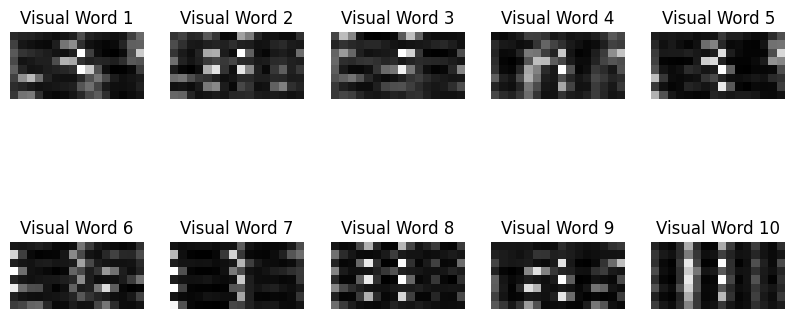

In [130]:
def visualize_codebook(codebook):
    """ 
    Visualization of some words of the codebook.
    
    Input: codebook, 2D numpy array where each row is a cluster center.
    """
    plt.figure(figsize=(10, 5))
    for i in range(min(codebook.shape[0], 10)):  # Display up to 10 visual words
        plt.subplot(2, 5, i + 1)
        plt.imshow(codebook[i].reshape((8, 16)), cmap='gray')
        plt.title(f"Visual Word {i+1}")
        plt.axis('off')
    plt.show()

visualize_codebook(codebook)

In [131]:
def extract_features(kmeans, descriptor_list, IMAGE_COUNT, N_CLUSTERS):
    """
    Extract features from images.

    Inputs:
        - kmeans: MiniBatchKMeans fitted model.
        - descriptor_list: list of image descriptors.
        - IMAGE_COUNT: global variable, total number of images.
        - N_CLUSTERS: global variable, number of clusters.
    Output: features: list of image features.
    """
    features = np.array([np.zeros(N_CLUSTERS) for i in range(IMAGE_COUNT)])

    for i in range(IMAGE_COUNT):
        for j in range(len(descriptor_list[i])):
            feature = descriptor_list[i][j]
            feature = feature.reshape(1, 128)
            idx = kmeans.predict(feature)
            features[i][idx] += 1

    return features

In [132]:
features = extract_features(kmeans, descriptors_list, IMAGE_COUNT, N_CLUSTERS)
print("Images features extracted.")

from sklearn.preprocessing import StandardScaler

scale = StandardScaler().fit(features)        
features = scale.transform(features)
print("Train images normalized.")

Images features extracted.
Train images normalized.


### Step 4: Feature Encoding
- **Objective**: Encode each image as a frequency histogram of visual words.
- **Guide**: For each image, count how many features fall into each cluster (visual word) and create a histogram.

In [133]:
def generalHistogram(features):
    """ 
    Build a general histogram of the vocabulary.

    Input: features, ndarray of the features of the images.
    """
    x_scalar = np.arange(N_CLUSTERS)
    y_scalar = np.array([abs(np.sum(features[:,h], dtype=np.int32)) for h in range(N_CLUSTERS)])

    plt.bar(x_scalar, y_scalar)
    plt.xlabel("Visual Word Index")
    plt.ylabel("Frequency")
    plt.title("Complete Vocabulary Generated")
    plt.xticks(x_scalar + 0.4, x_scalar)
    plt.show()

def plotImageHistogram(features,image_index):
    """ 
    Build individual histograms for each images.

    Input: 
        - features: ndarray of the features of the images.
        - image_index: int, index of the image to display.
    """
    x_scalar = np.arange(N_CLUSTERS)
    y_scalar = features[image_index]
    img = images[image_index]

    #Plot image
    plt.subplot(1, 2, 1)
    plt.imshow(img, cmap='gray'), plt.title(f"Image {image_index}"), plt.axis('off')

    #Plot image's histogram
    plt.subplot(1, 2, 2)
    plt.bar(x_scalar, y_scalar), plt.xlabel("Visual Word Index"), plt.ylabel("Frequency")
    plt.title(f"Histogram for Image {image_index}"), plt.xticks(x_scalar + 0.4, x_scalar)

    plt.tight_layout()
    plt.show()

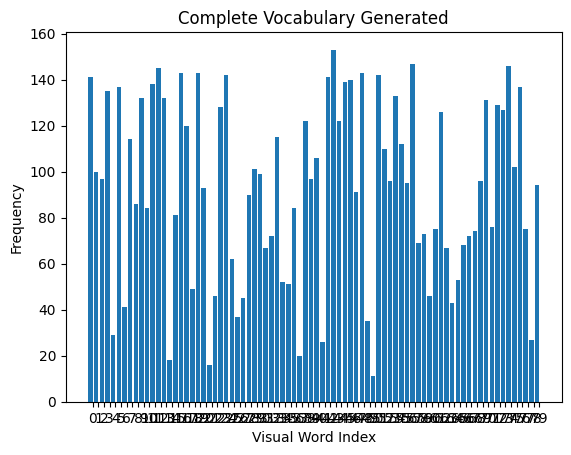

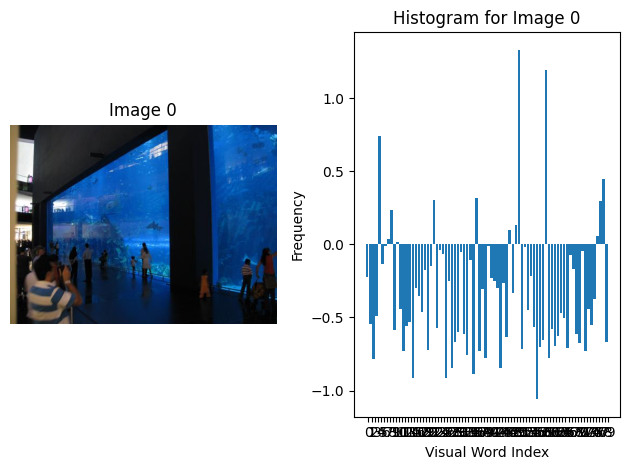

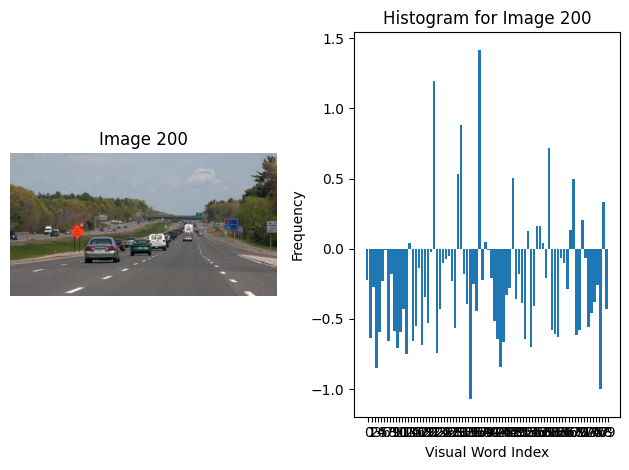

Histograms ready!


In [134]:
generalHistogram(features)
plotImageHistogram(features, image_index = 0)
plotImageHistogram(features, image_index = 200)
print("Histograms ready!")

### Step 5: Classifier Training
- **Objective**: Train a machine learning model to classify the images.
- **Guide**: Use the histograms as input features for a classifier. Any supervised classifier can be used (SVM, Random Forest, KNN, Neural nets, ...)

In [135]:
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV

def svcParamSelection(X, y, kernel, nfolds):
    """ 
    Select most optimal parameters for SVM.

    Input:
        - X: features: ndarray of the features of the images.
        - y: labels: list of numerical labels of images. Lenght = number of images.
        - kernel: type of kernel.
        - nfolds: int, times model is evaluated (cross-validation strategy).
    Output: grid_search.best_params_: dictionary with best hyperparameters.
    """
    Cs = [0.5, 0.1, 0.15, 0.2, 0.3]
    gammas = [0.1, 0.11, 0.095, 0.105]
    param_grid = {'C': Cs, 'gamma' : gammas}
    grid_search = GridSearchCV(SVC(kernel=kernel), param_grid, cv=nfolds)
    grid_search.fit(X, y)
    grid_search.best_params_
    return grid_search.best_params_

def findSVM(features, labels, kernel="linear"):
    """ 
    Fit a SVM model.

    Input:
        - features: ndarray of the features of the images.
        - labels: list of numerical labels of images. Lenght = number of images.
        - kernel: type of kernel.
    Output: svm: fitted SVM model.
    """
    params = svcParamSelection(features, labels, kernel, 5)
    C_param, gamma_param = params.get("C"), params.get("gamma")
    print(C_param, gamma_param)
    
    class_weight = { 
        0: (IMAGE_COUNT / (N_CLASSES * SAMPLES_X_CLASS[0])),
        1: (IMAGE_COUNT / (N_CLASSES * SAMPLES_X_CLASS[1])),
        2: (IMAGE_COUNT / (N_CLASSES * SAMPLES_X_CLASS[2])),
        3: (IMAGE_COUNT / (N_CLASSES * SAMPLES_X_CLASS[3])),
        4: (IMAGE_COUNT / (N_CLASSES * SAMPLES_X_CLASS[4])),
        5: (IMAGE_COUNT / (N_CLASSES * SAMPLES_X_CLASS[5])),
        6: (IMAGE_COUNT / (N_CLASSES * SAMPLES_X_CLASS[6])),
        7: (IMAGE_COUNT / (N_CLASSES * SAMPLES_X_CLASS[7]))
    }
  
    svm = SVC(kernel = kernel, C =  C_param, gamma = gamma_param, class_weight = class_weight)
    svm.fit(features, labels)
    return svm


In [136]:
svm = findSVM(features, train_labels, kernel="linear")
print("SVM fitted.")
print("Training completed.")

0.1 0.1
SVM fitted.
Training completed.


### Step 6: Model Evaluation
- **Objective**: Evaluate the performance of the classifier.
- **Guide**: Use a confusion matrix to visualize the performance and extract metrics.

In [137]:
from sklearn.metrics import confusion_matrix

def plotConfusionMatrix(y_true, y_pred, classes,normalize=False,title=None,cmap=plt.cm.Blues):
    """ 
    Plot the confusion matrix.
    
    Input:
        - y_true: true_labels: list of true labels.
        - y_pred: predictions: list of predicted labels.
        - classes: class_names: list of class names. Lenght = number of classes.
        - normalize: bool, whether to normalize confusion matrix or not.
    """
    if not title:
        if normalize:
            title = 'Normalized confusion matrix'
        else:
            title = 'Confusion matrix, without normalization'

    cm = confusion_matrix(y_true, y_pred)
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    fig, ax = plt.subplots()
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    ax.set(xticks=np.arange(cm.shape[1]),yticks=np.arange(cm.shape[0]),xticklabels=classes,
           yticklabels=classes,title=title,ylabel='True label',xlabel='Predicted label')

    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",rotation_mode="anchor")

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    return ax

def plotConfusions(true_labels, predictions):
    """ 
    Plot confusion matrices.

    Input:
        - true_labels: list of true labels.
        - predictions: list of predicted labels.
    """
    np.set_printoptions(precision=2)

    class_names = list(set(true_labels))
    plotConfusionMatrix(true_labels, predictions, classes=class_names,
                      title='Confusion matrix, without normalization')

    plotConfusionMatrix(true_labels, predictions, classes=class_names, normalize=True,
                      title='Normalized confusion matrix')

    plt.show()

from sklearn.metrics import accuracy_score

def findAccuracy(true_labels, predictions):
    """ 
    Find accuracy of our model.

    Input:
        - true_labels: list of true labels.
        - predictions: list of predicted labels.
    """
    print ('Accuracy score: %0.3f' % accuracy_score(true_labels, predictions))

def countCorrectIncorrect(true, predictions):
    """ 
    Count how many images were predicted correctly and incorrectly.

    Input:
        - true_labels: list of true labels.
        - predictions: list of predicted labels.
    """
    correct_count = sum(1 for true_label, pred_label in zip(true, predictions) if true_label == pred_label)
    incorrect_count = len(true) - correct_count
    return correct_count, incorrect_count

def plotSampleImages(true, predictions, test_images, class_name_dict):
    """ 
    Plot correctly predicted images to see examples.

    Input:
        - true_labels: list of true labels.
        - predictions: list of predicted labels.
        - test_images: list of test images.
        - class_name_dict: dictionary with the class names and indices.
    """
    for class_id, class_name in class_name_dict.items():
        class_images = [img for img, true_label, pred_label in zip(test_images, true, predictions) if true_label == class_name and pred_label == class_name]

        if class_images:
            print(f"Sample images for class {class_name}:")
            plt.figure(figsize=(12, 12))
            for i, img in enumerate(class_images[:4]):  # Display the first 4 images
                plt.subplot(1, 4, i + 1)
                plt.imshow(img, cmap='gray')
                plt.title(f"Image {i + 1}")
                plt.axis('off')
            plt.show()

def plotMisclassifiedImages(true_labels, predictions, test_images, class_name_dict):
    """ 
    Plot incorrectly predicted images to see examples.

    Input:
        - true_labels: list of true labels.
        - predictions: list of predicted labels.
        - test_images: list of test images.
        - class_name_dict: dictionary with the class names and indices.
    """
    misclassified_images = [(img, true_label, pred_label) for img, true_label, pred_label in zip(test_images, true_labels, predictions) if true_label != pred_label]

    if misclassified_images:
        plt.figure(figsize=(20, 20))
        num_images_to_display = min(20, len(misclassified_images))
        for i, (img, true_label, pred_label) in enumerate(misclassified_images[:num_images_to_display]):
            plt.subplot(4, 5, i + 1)  # 4x5 grid for 20 images
            plt.imshow(img, cmap='gray')
            true_name = class_name_dict.get(true_label, f"{true_label}")
            pred_name = class_name_dict.get(pred_label, f"{pred_label}")
            plt.title(f"True: {true_name}\nPred: {pred_name}")
            plt.axis('off')
        plt.show()
    else:
        print("No misclassified images.")


Test labels set:  {'park', 'laundromat', 'kitchen', 'windmill', 'highway', 'desert', 'waterfall', 'aquarium'}
Test labels dictionary:  {'0': 'park', '1': 'laundromat', '2': 'kitchen', '3': 'windmill', '4': 'highway', '5': 'desert', '6': 'waterfall', '7': 'aquarium'}
Test images classified.
Confusion matrix, without normalization
[[14  1  1  1  1  1  1  0]
 [ 0 12  1  0  1  0  3  3]
 [ 0  3  9  0  3  1  1  3]
 [ 1  0  1 14  4  0  0  0]
 [ 0  0  1  7 12  0  0  0]
 [ 0  1  1  0  0 10  1  7]
 [ 0  0  3  0  0  7 10  0]
 [ 1  5  0  0  1  5  0  8]]
Normalized confusion matrix
[[0.7  0.05 0.05 0.05 0.05 0.05 0.05 0.  ]
 [0.   0.6  0.05 0.   0.05 0.   0.15 0.15]
 [0.   0.15 0.45 0.   0.15 0.05 0.05 0.15]
 [0.05 0.   0.05 0.7  0.2  0.   0.   0.  ]
 [0.   0.   0.05 0.35 0.6  0.   0.   0.  ]
 [0.   0.05 0.05 0.   0.   0.5  0.05 0.35]
 [0.   0.   0.15 0.   0.   0.35 0.5  0.  ]
 [0.05 0.25 0.   0.   0.05 0.25 0.   0.4 ]]


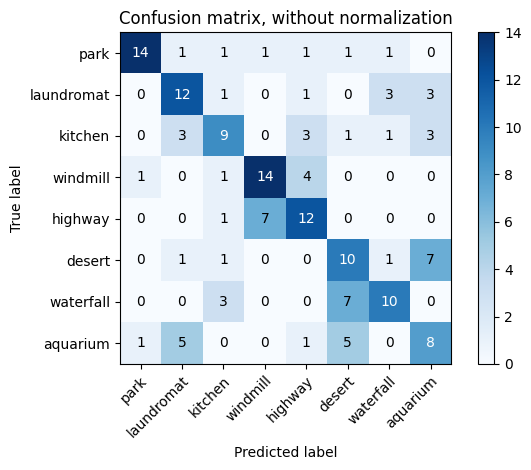

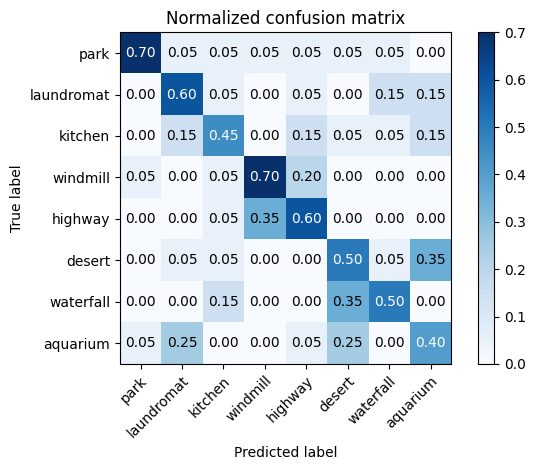

Confusion matrixes plotted.
Accuracy score: 0.556
Accuracy calculated.
Correctly classified images: 89
Incorrectly classified images: 71

TEST IMAGES CLASSIFIED CORRECTLY:

Sample images for class park:


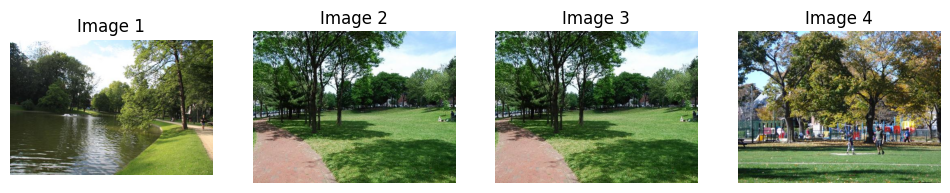

Sample images for class laundromat:


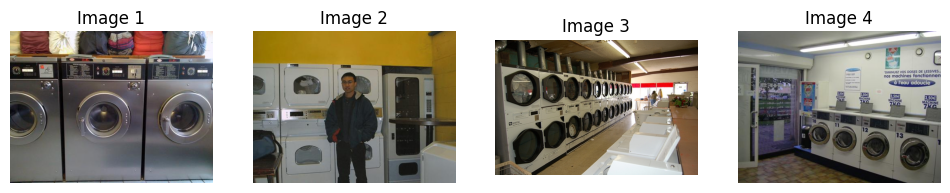

Sample images for class kitchen:


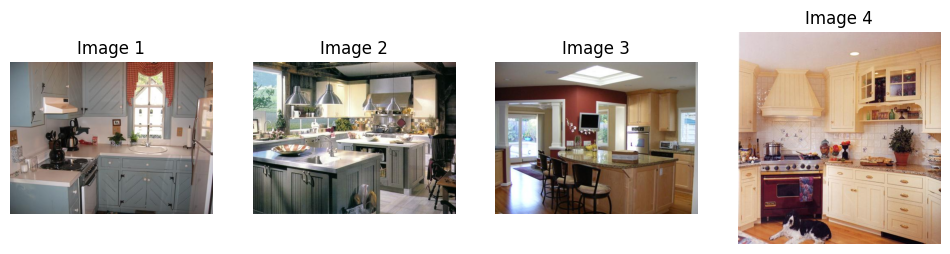

Sample images for class windmill:


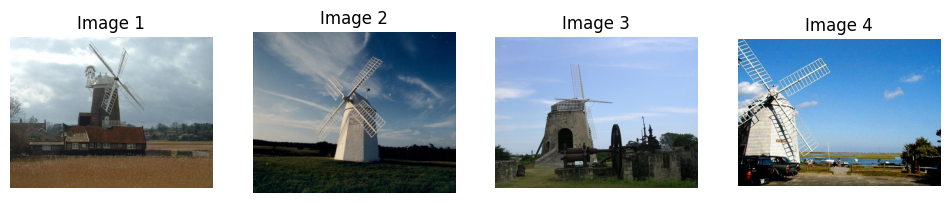

Sample images for class highway:


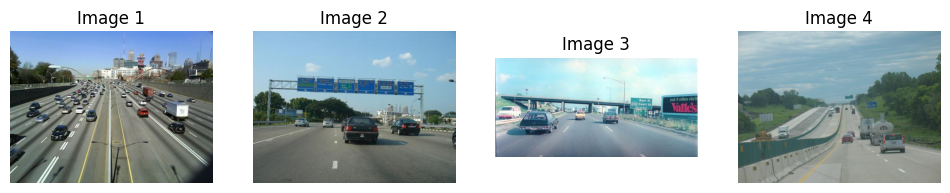

Sample images for class desert:


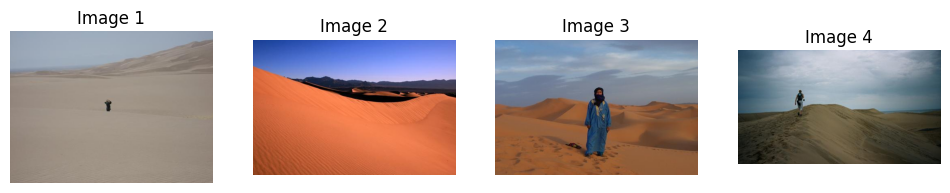

Sample images for class waterfall:


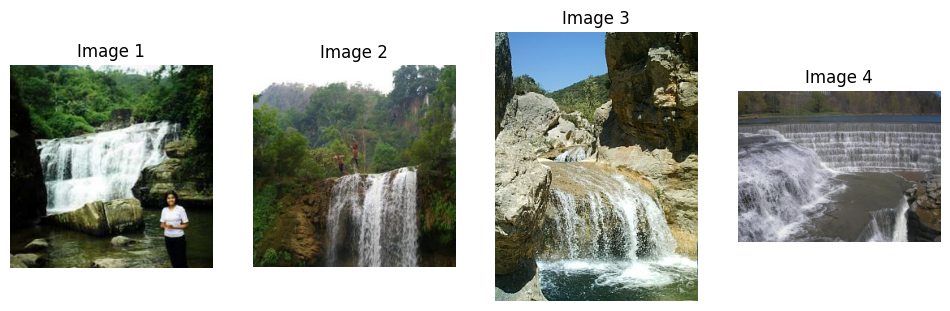

Sample images for class aquarium:


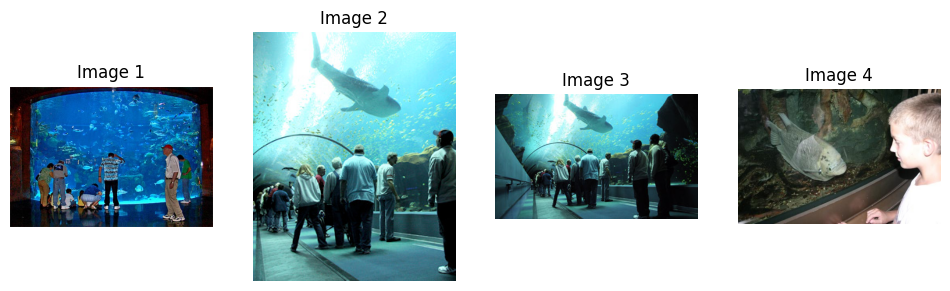


TEST IMAGES CLASSIFIED INCORRECTLY:



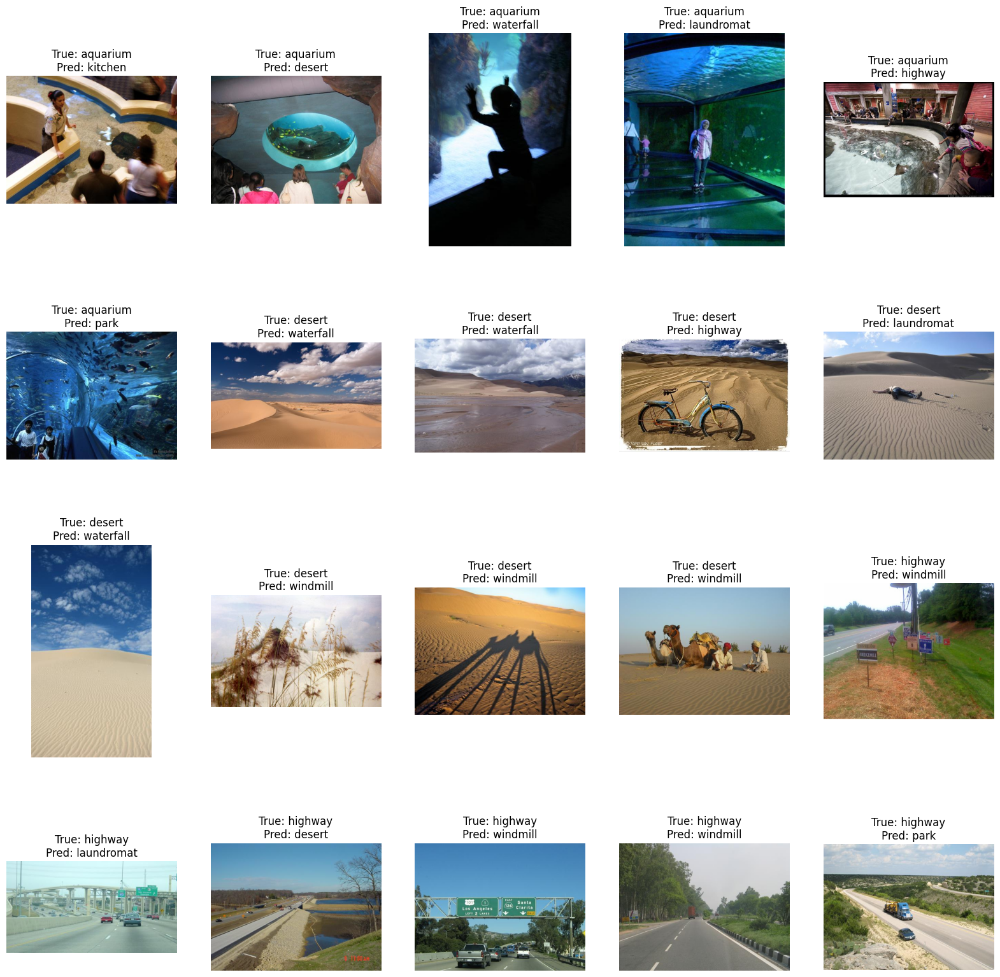

Execution done.


In [95]:
#Extract descriptors and features from test images
sift = cv2.SIFT_create()
descriptors_test, descriptors_list_test = extract_descriptors(test_images)
test_features = extract_features(kmeans,descriptors_list_test,len(test_images),N_CLUSTERS)
test_features = scale.transform(test_features)

kernel_test = test_features

#Get a set and a dictionary of the true labels of the test images
labels_set = set(true_labels)
print("Test labels set: ",labels_set)
test_labels_dict = {str(i): label for i, label in enumerate(labels_set, start=0)}
print("Test labels dictionary: ",test_labels_dict)

#Test images category prediction
predictions = [test_labels_dict[str(int(i))] for i in svm.predict(kernel_test)]
print("Test images classified.")

plotConfusions(true_labels, predictions)
print("Confusion matrixes plotted.")

findAccuracy(true_labels, predictions)
print("Accuracy calculated.")

correct_count, incorrect_count = countCorrectIncorrect(true_labels, predictions)
print(f"Correctly classified images: {correct_count}")
print(f"Incorrectly classified images: {incorrect_count}")

print("\nTEST IMAGES CLASSIFIED CORRECTLY:\n")
plotSampleImages(true_labels, predictions, test_images, test_labels_dict)
print("\nTEST IMAGES CLASSIFIED INCORRECTLY:\n")
plotMisclassifiedImages(true_labels, predictions, test_images, test_labels_dict)

print("Execution done.")
